# Table of contents
1. [Imports](#imports-section)
2. [Data Exploration](#de-section)
    1. [Handle the case where author is null](#na-section)
    2. [Handle the case where publisher is null](#np-section)
    3. [Clean location values](#clv-section)
    4. [Handle the missing values of users age](#nua-section)
    5. [Unique value plots](#uvp-section)
    6. [Verify if the year has only numeric values, and handle non-numeric ones if found](#vynv-section)
    7. [Statistics](#plot-section)
3. [Top rated books](#trb-section)
4. [Content-based Recommendation System](#cbrs-section)
5. [Collaborative-filtering Recommendation System](#cfrs-section)
6. [Scrappers](#scrap-section)

# Imports <div id='imports-section'/>

In [1]:
import requests
import os

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import CountVectorizer

import pickle
from scipy.spatial import distance
from sklearn.decomposition import PCA

from bs4 import BeautifulSoup
import kagglehub

import warnings
warnings.filterwarnings('ignore')

C:\Users\mosul\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [17]:
path = kagglehub.dataset_download("arashnic/book-recommendation-dataset")

In [18]:
path

'C:\\Users\\mosul\\.cache\\kagglehub\\datasets\\arashnic\\book-recommendation-dataset\\versions\\3'

# Data Exploration <div id='de-section'/>

Link to the dataset: [Book Recommendation Dataset](https://www.kaggle.com/datasets/arashnic/book-recommendation-dataset?select=Books.csv)

In [19]:
books = pd.read_csv("./Books.csv")
ratings = pd.read_csv("./Ratings.csv")
users = pd.read_csv("./Users.csv")

In [20]:
books.head(5)

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...


In [21]:
ratings.head(5)

,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


In [22]:
users.head(5)

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


In [23]:
print("Books Shape: " ,books.shape )
print("Ratings Shape: " ,ratings.shape )
print("Users Shape: " ,users.shape )

Books Shape:  (271360, 8)
Ratings Shape:  (1149780, 3)
Users Shape:  (278858, 3)


In [24]:
print("Number of null values in Books:")
print(books.isnull().sum())
print("---------------------------------")
print("Number of null values in Ratings:")
print(ratings.isnull().sum())
print("---------------------------------")
print("Number of null values in Users:")
print(users.isnull().sum())

Number of null values in Books:
ISBN                   0
Book-Title             0
Book-Author            2
Year-Of-Publication    0
Publisher              2
Image-URL-S            0
Image-URL-M            0
Image-URL-L            3
dtype: int64
---------------------------------
Number of null values in Ratings:
User-ID        0
ISBN           0
Book-Rating    0
dtype: int64
---------------------------------
Number of null values in Users:
User-ID          0
Location         0
Age         110762
dtype: int64


### Handle the case where author is null <div id='na-section'/>

In [25]:
books[books["Book-Author"].isna()]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
118033,0751352497,A+ Quiz Masters:01 Earth,NaN,1999,Dorling Kindersley,http://images.amazon.com/images/P/0751352497.0...,http://images.amazon.com/images/P/0751352497.0...,http://images.amazon.com/images/P/0751352497.0...
187689,9627982032,The Credit Suisse Guide to Managing Your Perso...,NaN,1995,Edinburgh Financial Publishing,http://images.amazon.com/images/P/9627982032.0...,http://images.amazon.com/images/P/9627982032.0...,http://images.amazon.com/images/P/9627982032.0...


I searched "The Credit Suisse Guide to Managing Your Personal Wealth" on google and found out that the author is Larissa Anne Downes 

In [26]:
books.loc[books["ISBN"] == "9627982032", ["Book-Author"]] = "Larissa Anne Downes"

In [27]:
books.loc[books["ISBN"] == "9627982032"]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
187689,9627982032,The Credit Suisse Guide to Managing Your Perso...,Larissa Anne Downes,1995,Edinburgh Financial Publishing,http://images.amazon.com/images/P/9627982032.0...,http://images.amazon.com/images/P/9627982032.0...,http://images.amazon.com/images/P/9627982032.0...


For "A+ Quiz Masters:01 Earth" I did not found an author, for this case the value will be set as "Unknown"


In [28]:
books.loc[books["ISBN"] == "0751352497", ["Book-Author"]] = "Unknown"

In [29]:
books.loc[books["ISBN"] == "0751352497"]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
118033,0751352497,A+ Quiz Masters:01 Earth,Unknown,1999,Dorling Kindersley,http://images.amazon.com/images/P/0751352497.0...,http://images.amazon.com/images/P/0751352497.0...,http://images.amazon.com/images/P/0751352497.0...


### Handle the case where publisher is null <div id='np-section'/>

In [30]:
books[books["Publisher"].isna()]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
128890,193169656X,Tyrant Moon,Elaine Corvidae,2002,NaN,http://images.amazon.com/images/P/193169656X.0...,http://images.amazon.com/images/P/193169656X.0...,http://images.amazon.com/images/P/193169656X.0...
129037,1931696993,Finders Keepers,Linnea Sinclair,2001,NaN,http://images.amazon.com/images/P/1931696993.0...,http://images.amazon.com/images/P/1931696993.0...,http://images.amazon.com/images/P/1931696993.0...


Both Tyrant Moon (2002) and Finders Keepers (2001) have the same publisher "NovelBooks"

In [31]:
books.loc[books["ISBN"] == "193169656X", ["Publisher"]] = "NovelBooks"

In [32]:
books.loc[books["ISBN"] == "193169656X"]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
128890,193169656X,Tyrant Moon,Elaine Corvidae,2002,NovelBooks,http://images.amazon.com/images/P/193169656X.0...,http://images.amazon.com/images/P/193169656X.0...,http://images.amazon.com/images/P/193169656X.0...


In [33]:
books.loc[books["ISBN"] == "1931696993", ["Publisher"]] = "NovelBooks"

In [34]:
books.loc[books["ISBN"] == "1931696993"]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
129037,1931696993,Finders Keepers,Linnea Sinclair,2001,NovelBooks,http://images.amazon.com/images/P/1931696993.0...,http://images.amazon.com/images/P/1931696993.0...,http://images.amazon.com/images/P/1931696993.0...


### Clean location values <div id='clv-section'/>

By cleaning the values of location, I mean keeping only the country

In [35]:
users.head()

,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


In [36]:
# keep only the part of the string, after the last comma
users['Location'] = users['Location'].apply(lambda x: x.split(',')[-1].strip())

In [37]:
users.head()

,User-ID,Location,Age
0,1,usa,NaN
1,2,usa,18.0
2,3,russia,NaN
3,4,portugal,17.0
4,5,united kingdom,NaN


In [38]:
users.loc[users["Location"] == "n/a"] 

,User-ID,Location,Age
3095,3096,n/a,NaN
10646,10647,n/a,NaN
11675,11676,n/a,NaN
42828,42829,n/a,NaN
61592,61593,n/a,NaN
64947,64948,n/a,NaN
70062,70063,n/a,NaN
86150,86151,n/a,60.0
99705,99706,n/a,NaN
119402,119403,n/a,15.0


I will replace the "n/a" values with the most frequent country from that column

In [39]:
most_common_country = users['Location'].mode()[0]

In [40]:
most_common_country

'usa'

In [41]:
users.loc[users["Location"] == "n/a", ["Location"]] = most_common_country

In [42]:
users.loc[users["Location"] == "n/a"] 

,User-ID,Location,Age


### Handle the missing values of users age <div id='nua-section'/>

In [43]:
users.loc[users["Age"].isna()].shape

(110762, 3)

In [44]:
users.shape

(278858, 3)

In [45]:
user_ratings = users.merge(ratings,on="User-ID")

In [46]:
merged_df = books.merge(user_ratings, on="ISBN")

In [47]:
merged_df.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Location,Age,Book-Rating
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,2,usa,18.0,0
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,8,canada,NaN,5
2,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,11400,canada,49.0,0
3,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,11676,usa,NaN,8
4,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,41385,canada,NaN,0


In [48]:
merged_df.shape

(1031136, 12)

In [49]:
df_for_regression = merged_df[["ISBN", "Book-Title", "Book-Author", "Publisher", "Age", "Book-Rating", "Location"]]

In [50]:
df_for_regression.head()

,ISBN,Book-Title,Book-Author,Publisher,Age,Book-Rating,Location
0,0195153448,Classical Mythology,Mark P. O. Morford,Oxford University Press,18.0,0,usa
1,0002005018,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,NaN,5,canada
2,0002005018,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,49.0,0,canada
3,0002005018,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,NaN,8,usa
4,0002005018,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,NaN,0,canada


In [51]:
label_encoder = LabelEncoder()

df_for_regression['Publisher'] = label_encoder.fit_transform(df_for_regression['Publisher'])
df_for_regression['Book-Author'] = label_encoder.fit_transform(df_for_regression['Book-Author'])
df_for_regression['Book-Title'] = label_encoder.fit_transform(df_for_regression['Book-Title'])
df_for_regression['Location'] = label_encoder.fit_transform(df_for_regression['Location'])

In [52]:
df_for_regression.head()

,ISBN,Book-Title,Book-Author,Publisher,Age,Book-Rating,Location
0,0195153448,36197,64912,10925,18.0,0,271
1,0002005018,36036,81125,6640,NaN,5,42
2,0002005018,36036,81125,6640,49.0,0,42
3,0002005018,36036,81125,6640,NaN,8,271
4,0002005018,36036,81125,6640,NaN,0,42


In [53]:
cormat = df_for_regression[["Book-Title", "Book-Author", "Publisher", "Age", "Book-Rating", "Location"]].corr()

In [54]:
cormat

,Book-Title,Book-Author,Publisher,Age,Book-Rating,Location
Book-Title,1.000000,0.009033,0.005757,0.004365,0.000059,0.012908
Book-Author,0.009033,1.000000,0.035347,-0.000277,-0.002288,-0.000516
Publisher,0.005757,0.035347,1.000000,-0.008890,-0.000432,0.007537
Age,0.004365,-0.000277,-0.008890,1.000000,-0.025252,0.080658
Book-Rating,0.000059,-0.002288,-0.000432,-0.025252,1.000000,-0.028612
Location,0.012908,-0.000516,0.007537,0.080658,-0.028612,1.000000


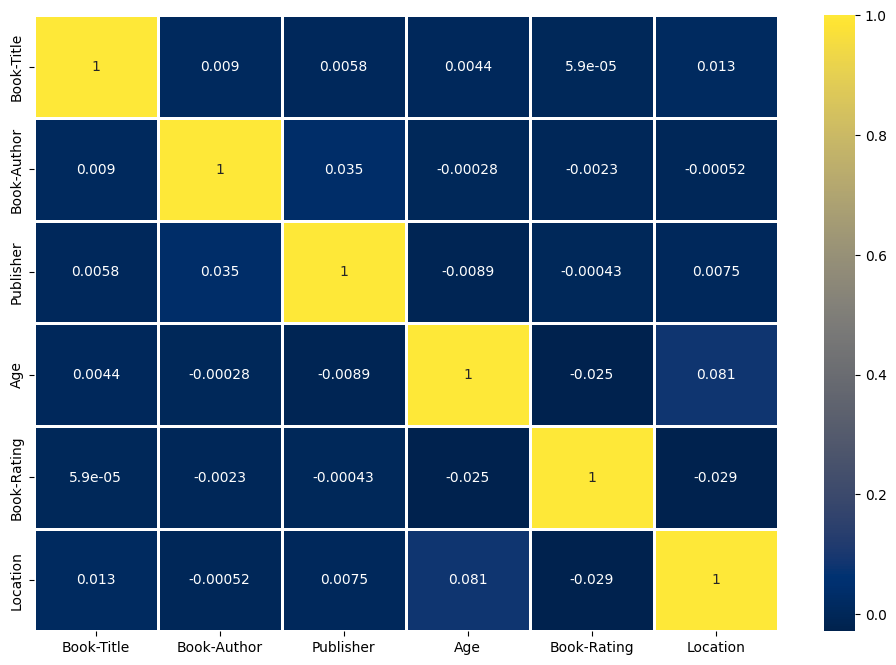

In [55]:
plt.figure(figsize=(12, 8))
sns.heatmap(cormat, cmap='cividis', annot=True, linewidths=2)
plt.show()

The correlation matrix shows us that the data is not strongly correlated

In [56]:
users = users.drop(['Age'], axis=1)

In [57]:
users.head()

,User-ID,Location
0,1,usa
1,2,usa
2,3,russia
3,4,portugal
4,5,united kingdom


### Handle ratings with rating score 0 <div id='hrs-section'/>

In [58]:
ratings.head()

,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


In [59]:
ratings.loc[ratings["Book-Rating"] == 0].shape

(716109, 3)

In [60]:
ratings.shape

(1149780, 3)

Below, we will replace the rating values for rows with rating 0, with the median rating per book

In [61]:
median_ratings = ratings.groupby('ISBN')['Book-Rating'].median()
median_ratings = median_ratings.astype(int)

In [62]:
median_ratings.head()

ISBN
0330299891    3
0375404120    1
0586045007    0
9022906116    3
9032803328    0
Name: Book-Rating, dtype: int64

In [63]:
ratings['Book-Rating'] = ratings.apply(lambda row: median_ratings[row['ISBN']] if row['Book-Rating'] == 0 else row['Book-Rating'], axis=1)

In [64]:
ratings.head()

,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


In [65]:
print(f"Number of 0 values: {median_ratings.loc[median_ratings == 0].shape[0]}")
print(f"Total number of values: {median_ratings.shape[0]}")

Number of 0 values: 199933
Total number of values: 340556


In [66]:
ratings.loc[ratings["Book-Rating"] == 0].shape

(617548, 3)

We reduced the rows that have rating equal to 0 from 716109 to 617548

Next, let's try to reduce this number by using the median rating per user

In [67]:
median_ratings_per_user = ratings.groupby('User-ID')['Book-Rating'].median()
median_ratings_per_user = median_ratings_per_user .astype(int)

In [68]:
print(f"Number of 0 values: {median_ratings_per_user.loc[median_ratings_per_user == 0].shape[0]}")
print(f"Total number of values: {median_ratings_per_user.shape[0]}")

Number of 0 values: 30243
Total number of values: 105283


In [69]:
ratings['Book-Rating'] = ratings.apply(lambda row: median_ratings_per_user[row['User-ID']] if row['Book-Rating'] == 0 else row['Book-Rating'], axis=1)

In [70]:
ratings.loc[ratings["Book-Rating"] == 0].shape

(491116, 3)

Now, the number of ratings with value 0  was reduced to 491116

In [71]:
ratings = ratings[ratings['Book-Rating'] != 0]

In [72]:
ratings.shape

(658664, 3)

Old rating df number of rows: 1149780

Rating df number of rows after modifications: 1149780

### Unique value plots <div id='uvp-section'/>

In [73]:
distinct_books = books.nunique()
distinct_ratings = ratings.nunique()
distinct_users = users.nunique()

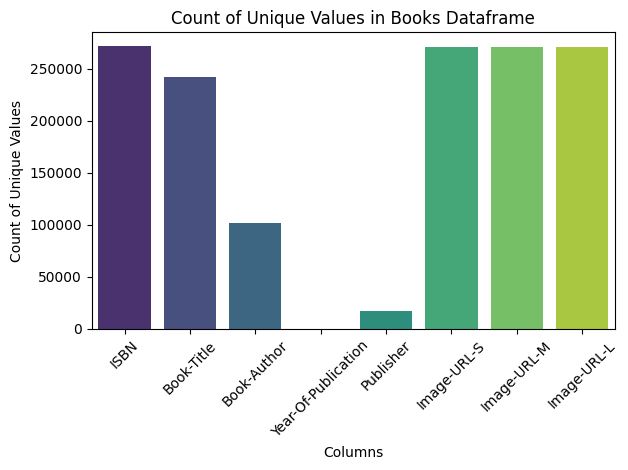

In [74]:
sns.barplot(x=distinct_books.index, y=distinct_books.values, palette='viridis')
plt.title('Count of Unique Values in Books Dataframe')
plt.xlabel('Columns')
plt.ylabel('Count of Unique Values')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

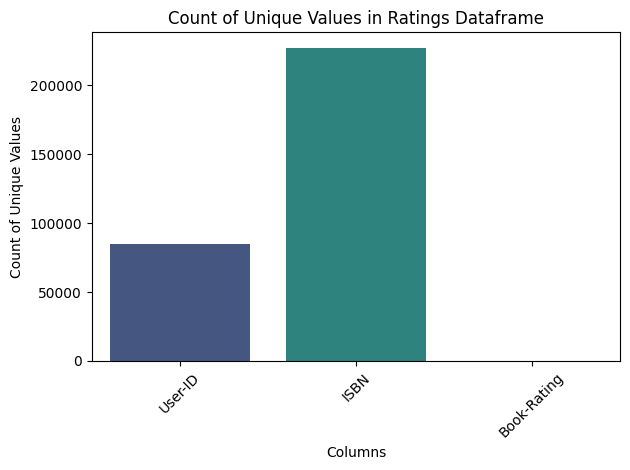

In [75]:
sns.barplot(x=distinct_ratings.index, y=distinct_ratings.values, palette='viridis')
plt.title('Count of Unique Values in Ratings Dataframe')
plt.xlabel('Columns')
plt.ylabel('Count of Unique Values')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

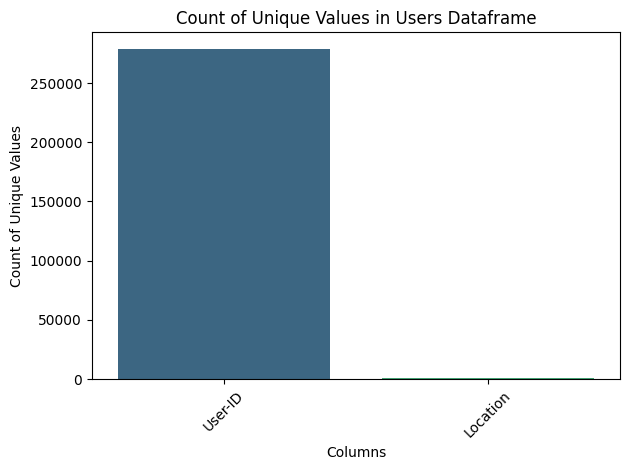

In [76]:
sns.barplot(x=distinct_users.index, y=distinct_users.values, palette='viridis')
plt.title('Count of Unique Values in Users Dataframe')
plt.xlabel('Columns')
plt.ylabel('Count of Unique Values')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### Verify if the year has only numeric values, and handle non-numeric ones if found <div id='vynv-section'/>

In [77]:
books['Year-Of-Publication'] = pd.to_numeric(books['Year-Of-Publication'], errors='coerce')

non_int_rows = books[pd.isna(books['Year-Of-Publication'])]

In [78]:
books.isna().sum()

ISBN                   0
Book-Title             0
Book-Author            0
Year-Of-Publication    3
Publisher              0
Image-URL-S            0
Image-URL-M            0
Image-URL-L            3
dtype: int64

In [79]:
books[books["Image-URL-L"].isna()]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
209538,078946697X,"DK Readers: Creating the X-Men, How It All Beg...",2000,NaN,http://images.amazon.com/images/P/078946697X.0...,http://images.amazon.com/images/P/078946697X.0...,http://images.amazon.com/images/P/078946697X.0...,NaN
220731,2070426769,"Peuple du ciel, suivi de 'Les Bergers\"";Jean-M...",2003,NaN,http://images.amazon.com/images/P/2070426769.0...,http://images.amazon.com/images/P/2070426769.0...,http://images.amazon.com/images/P/2070426769.0...,NaN
221678,0789466953,"DK Readers: Creating the X-Men, How Comic Book...",2000,NaN,http://images.amazon.com/images/P/0789466953.0...,http://images.amazon.com/images/P/0789466953.0...,http://images.amazon.com/images/P/0789466953.0...,NaN


In [80]:
# Update year-of-publication with the values from book-author
books.loc[books["ISBN"] == "078946697X", ["Year-Of-Publication"]] = "2000"
books.loc[books["ISBN"] == "2070426769", ["Year-Of-Publication"]] = "2003"
books.loc[books["ISBN"] == "0789466953", ["Year-Of-Publication"]] = "2000"

In [81]:
# Update image-url-l with the values from publisher
books.loc[books["ISBN"] == "078946697X", ["Image-URL-L"]] = "http://images.amazon.com/images/P/078946697X.0"
books.loc[books["ISBN"] == "2070426769", ["Image-URL-L"]] = "http://images.amazon.com/images/P/2070426769.0"
books.loc[books["ISBN"] == "0789466953", ["Image-URL-L"]] = "http://images.amazon.com/images/P/0789466953.0"

In [82]:
#Update book-author
books.loc[books["ISBN"] == "078946697X", ["Book-Author"]] = "Michael Teitelbaum"
books.loc[books["ISBN"] == "2070426769", ["Book-Author"]] = "Jean-Marie Gustave Le Clezio"
books.loc[books["ISBN"] == "0789466953", ["Book-Author"]] = "James Buckley Jr"

In [83]:
#Update publisher
books.loc[books["ISBN"] == "078946697X", ["Publisher"]] = "DK Children"
books.loc[books["ISBN"] == "2070426769", ["Publisher"]] = "Gallimard Education"
books.loc[books["ISBN"] == "0789466953", ["Publisher"]] = "DK Children"

In [84]:
books.isna().sum()

ISBN                   0
Book-Title             0
Book-Author            0
Year-Of-Publication    0
Publisher              0
Image-URL-S            0
Image-URL-M            0
Image-URL-L            0
dtype: int64

### Statistics <div id='plot-section'/>

In [85]:
plot = books['Year-Of-Publication'].value_counts().head(10)
fig = px.bar(y=plot.values,
            x=plot.index,
            text=plot.values,
            title= "Top 10 years in which books were published in terms of count",
            template= "plotly_dark")
fig.update_layout(
    xaxis_title="Year",
    yaxis_title="Count")
fig.show()

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

In [120]:
plot = books['Book-Author'].value_counts().head(10)
fig = px.bar(y=plot.values,
            x=plot.index,
            text=plot.values,
            title= "Top 10 Authors with most books written",
            template= "plotly_dark")
fig.update_layout(
    xaxis_title="Author name",
    yaxis_title="Count")
fig.show()

In [121]:
plot = books['Publisher'].value_counts().head(10)
fig = px.bar(y=plot.values,
            x=plot.index,
            text=plot.values,
            title= "Top 10 Publisher with most books published",
            template= "plotly_dark")
fig.update_layout(
    xaxis_title="Publisher name",
    yaxis_title="Count")
fig.show()

# Top Rated Books <div id='trb-section'/>

In [122]:
books_with_ratings = books.merge(ratings, on="ISBN")

In [158]:
#Get top 30 most rated books
books_top_rated = books_with_ratings['Book-Title'].value_counts().head(30)

# transform the series into a list of titles
books_top_rated = list(books_top_rated.index)

#Create a new dataframe, whose purpose is to store all the ratings, and book data for the top rated books
highestRatingBooks = pd.DataFrame(columns = books_with_ratings.columns)


for book in books_top_rated:

    cond_df = books_with_ratings[books_with_ratings['Book-Title'] == book]
    highestRatingBooks =  pd.concat([highestRatingBooks, cond_df], axis=0)

#Calculate mean ratings and sort desc
highestRatingBooks = highestRatingBooks.groupby('Book-Title')['Book-Rating'].agg('mean').reset_index().sort_values(by='Book-Rating', ascending=False)

In [159]:
highestRatingBooks.head(10)

,Book-Title,Book-Rating
8,Harry Potter and the Goblet of Fire (Book 4),8.865633
9,Harry Potter and the Prisoner of Azkaban (Book 3),8.796729
7,Harry Potter and the Chamber of Secrets (Book 2),8.267161
10,Harry Potter and the Sorcerer's Stone (Harry P...,8.050435
26,To Kill a Mockingbird,7.925311
23,The Secret Life of Bees,7.84127
16,The Da Vinci Code,7.348264
11,Life of Pi,7.284274
21,The Notebook,7.278689
19,The Lovely Bones: A Novel,7.19305


# Content-based Recommendation System <div id='cbrs-section'/>

In [233]:
def ContentBasedRecommendations(isbn, merged_dataset):
    # preia isbn-ul cartii respective din dataframe dat ca parametru (acesta poate fi merge dintre books si ratings pe isbn, sau merge pe books-ratings-users)
    book = merged_dataset.loc[merged_dataset['ISBN'] == isbn]['ISBN']

    book_isbn = "";

    # separa cartile rare_books (carti cu mai putin de 20 review-uri) si common_books
    # aceasta separare se face cu scopul de a oferi ca recomandari carti populare similare cu cartea dorita
    count_rate = pd.DataFrame(merged_dataset['ISBN'].value_counts())
    rare_books = count_rate[count_rate["count"]<20].index
    common_books = merged_dataset[~merged_dataset["ISBN"].isin(rare_books)]

    r_books=[]

    #elimina duplicatele aparute in urma imbinarii cu dataframe-ul ratings
    common_books=common_books.drop_duplicates(subset=["ISBN"])

    # daca book este empty inseamna ca respectiva carte nu a avut niciun review, asadar dupa merge nu are cum sa apara in dataframe-ul rezultat
    # in cazul in care acest lucru se intampla, preluam linia corespunzatoare cartii din books, preluam isbn si adaugam acea linie la common books
        # tocmai pentru a putea recomanda carti populare raportate la cartea dorita
    if(book.empty):
        book = books.loc[books['ISBN'] == isbn]
        book_isbn = book.iloc[0][0]
        common_books = pd.concat([common_books,book], ignore_index = False)
    else:
        book_isbn = book.iloc[0]

    # daca respectiva carte se afla in rare_books, adaugam linia cu informatiile sale in common books
    if book_isbn in rare_books:
        book = books.loc[books['ISBN'] == isbn]
        book_isbn = book.iloc[0][0]
        common_books = pd.concat([common_books,book], ignore_index = False)

    common_books.reset_index(inplace=True)
    
    common_books["index"]=[i for i in range(common_books.shape[0])]
    common_books['ISBN'] = common_books['ISBN'].astype('object')
    common_books['Book-Title'] = common_books['Book-Title'].astype('object')
    common_books['Book-Author'] = common_books['Book-Author'].astype('object')
    common_books['Publisher'] = common_books['Publisher'].astype('object')

    # deoarce inca nu avem descriere si categorie pentru toate cartile, ne folosim de titlu, autor si editura pe care le adaugam intr-o coloana noua 
    targets=["Book-Title","Book-Author","Publisher"]
    common_books["all_features"] = [" ".join(common_books[targets].iloc[i,].values) for i in range(common_books[targets].shape[0])]
    
    # folosind CountVectorizer va fi creata o matrice pe ale carei coloane se afla cuvinte, iar pe linii propozitii
    # astfel la intersectia linie-coloana vom avea numarul de aparitii ale cuvantului in propozitia respectiva
    vectorizer=CountVectorizer()
    token_count_matrix=vectorizer.fit_transform(common_books["all_features"])

    # folosind cosine_similarity, obtinem o matrice de similitudini
    similarity=cosine_similarity(token_count_matrix)

    # preia index-ul cartii dorite
    index=common_books[common_books["ISBN"]==book_isbn]["index"].values[0]

    # creaza lista de perechi care contin index-ul unei carti si scorul de similitudine
    similar_books=list(enumerate(similarity[index]))

    # sortam lista de perechi in functie de scor, si stocam primele cele mai similare 10 perechi
    # excludem prima pereche deoarece aceasta contine cartea data ca input
    similar_booksSorted=sorted(similar_books,key=lambda x:x[1],reverse=True)[1:11]
    
    # pentru fiecare index din similar_booksSorted preluam isbn-ul cartii si il adaugam in lista ce urmeaza a fi returnata
    for i in range(len(similar_booksSorted)):
        r_books.append(common_books[common_books["index"]==similar_booksSorted[i][0]]["ISBN"].item())

    return r_books

In [161]:
input_isbn = '0439139597'

In [189]:
book = books_with_ratings.loc[books_with_ratings['ISBN'] == input_isbn]['ISBN']

In [190]:
count_rate = pd.DataFrame(books_with_ratings['ISBN'].value_counts())

In [191]:
rare_books = count_rate[count_rate["count"]<20].index
common_books = books_with_ratings[~books_with_ratings["ISBN"].isin(rare_books)]

In [192]:
common_books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Book-Rating
29,0399135782,The Kitchen God's Wife,Amy Tan,1991,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,5
30,0399135782,The Kitchen God's Wife,Amy Tan,1991,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,11676,9
31,0399135782,The Kitchen God's Wife,Amy Tan,1991,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,29526,9
32,0399135782,The Kitchen God's Wife,Amy Tan,1991,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,36836,5
33,0399135782,The Kitchen God's Wife,Amy Tan,1991,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,46398,9


In [193]:
r_books=[]

common_books=common_books.drop_duplicates(subset=["ISBN"])

In [194]:
common_books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Book-Rating
29,0399135782,The Kitchen God's Wife,Amy Tan,1991,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,5
87,0440234743,The Testament,John Grisham,1999,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,9,6
314,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,277711,2
441,1841721522,New Vegetarian: Bold and Beautiful Recipes for...,Celia Brooks Brown,2001,Ryland Peters &amp; Small Ltd,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,10,3
476,0971880107,Wild Animus,Rich Shapero,2004,Too Far,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,276939,7


In [195]:
if(book.empty):
    book = books.loc[books['ISBN'] == isbn]
    book_isbn = book.iloc[0][0]
    common_books = pd.concat([common_books,book], ignore_index = False)
else:
    book_isbn = book.iloc[0]

In [196]:
if book_isbn in rare_books:
    book = books.loc[books['ISBN'] == isbn]
    book_isbn = book.iloc[0][0]
    common_books = pd.concat([common_books,book], ignore_index = False)

common_books.reset_index(inplace=True)

In [197]:
common_books.head()

,index,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Book-Rating
0,29,0399135782,The Kitchen God's Wife,Amy Tan,1991,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,5
1,87,0440234743,The Testament,John Grisham,1999,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,9,6
2,314,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,277711,2
3,441,1841721522,New Vegetarian: Bold and Beautiful Recipes for...,Celia Brooks Brown,2001,Ryland Peters &amp; Small Ltd,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,10,3
4,476,0971880107,Wild Animus,Rich Shapero,2004,Too Far,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,276939,7


In [198]:
common_books["index"]=[i for i in range(common_books.shape[0])]
common_books['ISBN'] = common_books['ISBN'].astype('object')
common_books['Book-Title'] = common_books['Book-Title'].astype('object')
common_books['Book-Author'] = common_books['Book-Author'].astype('object')
common_books['Publisher'] = common_books['Publisher'].astype('object')

In [199]:
common_books.head()

,index,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Book-Rating
0,0,0399135782,The Kitchen God's Wife,Amy Tan,1991,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,5
1,1,0440234743,The Testament,John Grisham,1999,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,9,6
2,2,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,277711,2
3,3,1841721522,New Vegetarian: Bold and Beautiful Recipes for...,Celia Brooks Brown,2001,Ryland Peters &amp; Small Ltd,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,10,3
4,4,0971880107,Wild Animus,Rich Shapero,2004,Too Far,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,276939,7


In [200]:
targets=["Book-Title","Book-Author","Publisher"]
common_books["all_features"] = [" ".join(common_books[targets].iloc[i,].values) for i in range(common_books[targets].shape[0])]

In [201]:
common_books.head()

,index,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Book-Rating,all_features
0,0,0399135782,The Kitchen God's Wife,Amy Tan,1991,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,5,The Kitchen God's Wife Amy Tan Putnam Pub Group
1,1,0440234743,The Testament,John Grisham,1999,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,9,6,The Testament John Grisham Dell
2,2,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,277711,2,Beloved (Plume Contemporary Fiction) Toni Morr...
3,3,1841721522,New Vegetarian: Bold and Beautiful Recipes for...,Celia Brooks Brown,2001,Ryland Peters &amp; Small Ltd,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,10,3,New Vegetarian: Bold and Beautiful Recipes for...
4,4,0971880107,Wild Animus,Rich Shapero,2004,Too Far,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,276939,7,Wild Animus Rich Shapero Too Far


In [202]:
vectorizer=CountVectorizer()
token_count_matrix=vectorizer.fit_transform(common_books["all_features"])

In [206]:
similarity=cosine_similarity(token_count_matrix)

In [209]:
index=common_books[common_books["ISBN"]==book_isbn]["index"].values[0]

In [210]:
index

1258

In [211]:
similarity[index]

array([0.10540926, 0.14142136, 0.        , ..., 0.1118034 , 0.        ,
       0.08164966])

In [212]:
similar_books=list(enumerate(similarity[index]))

In [213]:
similar_books

[(0, 0.10540925533894598),
 (1, 0.1414213562373095),
 (2, 0.0),
 (3, 0.07669649888473705),
 (4, 0.0),
 (5, 0.0),
 (6, 0.0),
 (7, 0.0),
 (8, 0.0),
 (9, 0.0),
 (10, 0.0),
 (11, 0.0),
 (12, 0.2),
 (13, 0.11180339887498948),
 (14, 0.0),
 (15, 0.0912870929175277),
 (16, 0.14509525002200233),
 (17, 0.12909944487358058),
 (18, 0.0),
 (19, 0.0),
 (20, 0.10540925533894598),
 (21, 0.22360679774997896),
 (22, 0.0),
 (23, 0.07254762501100116),
 (24, 0.0),
 (25, 0.2449489742783178),
 (26, 0.2),
 (27, 0.253546276418555),
 (28, 0.0),
 (29, 0.0),
 (30, 0.16770509831248423),
 (31, 0.38138503569823695),
 (32, 0.0),
 (33, 0.1),
 (34, 0.12909944487358058),
 (35, 0.11952286093343936),
 (36, 0.0),
 (37, 0.0),
 (38, 0.0),
 (39, 0.16903085094570333),
 (40, 0.10540925533894598),
 (41, 0.2),
 (42, 0.10540925533894598),
 (43, 0.0),
 (44, 0.0),
 (45, 0.0),
 (46, 0.0),
 (47, 0.0),
 (48, 0.0),
 (49, 0.07669649888473705),
 (50, 0.0),
 (51, 0.0),
 (52, 0.0),
 (53, 0.19069251784911848),
 (54, 0.10540925533894598),
 (5

In [214]:
similar_booksSorted=sorted(similar_books,key=lambda x:x[1],reverse=True)[1:11]

In [215]:
similar_booksSorted

[(1518, 0.9534625892455926),
 (879, 0.7999999999999999),
 (958, 0.7999999999999999),
 (1259, 0.7999999999999999),
 (1416, 0.7999999999999999),
 (1274, 0.7893522173763264),
 (3579, 0.762770071396474),
 (741, 0.7378647873726218),
 (1836, 0.7378647873726218),
 (625, 0.5368754921931593)]

In [216]:
for i in range(len(similar_booksSorted)):
    r_books.append(common_books[common_books["index"]==similar_booksSorted[i][0]]["ISBN"].item())

In [217]:
r_books

['0439139600',
 '0439064872',
 '0439136350',
 '0439064864',
 '0439136369',
 '043935806X',
 '0439425220',
 '0590353403',
 '043936213X',
 '059035342X']

In [229]:
for i in range(len(similar_booksSorted)):
    print("ISBN: ", common_books[common_books["index"]==similar_booksSorted[i][0]]["ISBN"].item(), " al cartii ", common_books[common_books["index"]==similar_booksSorted[i][0]]["Book-Title"].item(), " publicata de ", common_books[common_books["index"]==similar_booksSorted[i][0]]["Publisher"].item(), " in anul ", common_books[common_books["index"]==similar_booksSorted[i][0]]["Year-Of-Publication"].item())

ISBN:  0439139600  al cartii  Harry Potter and the Goblet of Fire (Book 4)  publicata de  Scholastic Paperbacks  in anul  2002
ISBN:  0439064872  al cartii  Harry Potter and the Chamber of Secrets (Book 2)  publicata de  Scholastic  in anul  2000
ISBN:  0439136350  al cartii  Harry Potter and the Prisoner of Azkaban (Book 3)  publicata de  Scholastic  in anul  1999
ISBN:  0439064864  al cartii  Harry Potter and the Chamber of Secrets (Book 2)  publicata de  Scholastic  in anul  1999
ISBN:  0439136369  al cartii  Harry Potter and the Prisoner of Azkaban (Book 3)  publicata de  Scholastic  in anul  2001
ISBN:  043935806X  al cartii  Harry Potter and the Order of the Phoenix (Book 5)  publicata de  Scholastic  in anul  2003
ISBN:  0439425220  al cartii  Harry Potter and the Chamber of Secrets Postcard Book  publicata de  Scholastic  in anul  2002
ISBN:  0590353403  al cartii  Harry Potter and the Sorcerer's Stone (Book 1)  publicata de  Scholastic  in anul  1998
ISBN:  043936213X  al cart

Ca input am avut "Harry Potter and the Goblet of Fire (Book 4)" cu isbn 0439139597 publicata in anul 2000

In [234]:
isbnList = ContentBasedRecommendations(input_isbn, books_with_ratings)

In [235]:
isbnList

['0439139600',
 '0439064872',
 '0439136350',
 '0439064864',
 '0439136369',
 '043935806X',
 '0439425220',
 '0590353403',
 '043936213X',
 '059035342X']

In [236]:
books_with_ratings.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Book-Rating
0,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,8,5
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,11400,6
2,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,11676,8
3,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,41385,6
4,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,67544,8


# Collaborative-filtering Recommendation System <div id='cfrs-section'/>

In [240]:
def BookSimilarityInit(books_with_ratings):
    # generam un dataframe care contine doar utilizatorii care au dat rating pentru cel putin 20 de carti
    ratings_count = books_with_ratings.groupby('User-ID').count()['ISBN'].sort_values(ascending=False).reset_index()
    ratings_count.rename(columns={'ISBN':'NumberOfBooks'}, inplace=True)

    filtered_users = ratings_count[ratings_count['NumberOfBooks'] >= 20]

    # generam un dataframe care contine doar cartile care au cel putin 20 de rating-uri acordate
    books_ratings_count = ratings.merge(books, on="ISBN").groupby('Book-Title').count()['ISBN'].sort_values(ascending=False).reset_index()
    books_ratings_count.rename(columns={'ISBN':'NumberOfRatings'}, inplace=True)

    filtered_books = books_ratings_count[books_ratings_count['NumberOfRatings']>=20]

    # generam un dataframe care cotine datele filtrate anterior
    books_with_filtered_users = pd.merge(filtered_users, books_with_ratings, on='User-ID')

    filtered_data = pd.merge(filtered_books, books_with_filtered_users, on='Book-Title')

    # cream un tabel pivot, acesta continand toate combinatiile user-id - ISBN
    pivot_table = filtered_data.pivot_table(index='ISBN',columns='User-ID', values='Book-Rating')

    # inlocuim NaN cu 0 pentru a putea obtine matricea de similitudini
    pivot_table.fillna(0, inplace=True)

    similarity_matrix = cosine_similarity(pivot_table)

    return pivot_table, similarity_matrix

In [238]:
def FilteringCollaborationRecommendations(isbn, dataset):
    isbnList = []
    pivot_table, similarity_matrix = BookSimilarityInit(dataset)
    # np.where(pivot_table.index==isbn)[0][0] preia indexul la care gasim isbn-ul respectiv in tabela pivot
    # acest index va fi folosit pentru a cauta randul care contine scorurile de similitudine in raport cu isbn-ul dat ca input
    # preluam primele 10 isbn-uri cu scor cel mai mare, din care excludem prima pozitie, pe care se afla inputul
    for book in sorted(list(enumerate(similarity_matrix[np.where(pivot_table.index==isbn)[0][0]])), key=lambda x: x[1], reverse=True)[1:11]:
        isbnList.append(pivot_table.index[book[0]])

    return isbnList

In [241]:
pivot_table, similarity_matrix = BookSimilarityInit(books_with_ratings)

In [248]:
np.where(pivot_table.index==input_isbn)[0][0]

3291

In [254]:
for book in sorted(list(enumerate(similarity_matrix[np.where(pivot_table.index==input_isbn)[0][0]])), key=lambda x: x[1], reverse=True)[1:11]:
    print(books.loc[books["ISBN"] == pivot_table.index[book[0]]]["Book-Title"].item())

Harry Potter and the Prisoner of Azkaban (Book 3)
Harry Potter and the Chamber of Secrets (Book 2)
Harry Potter and the Sorcerer's Stone (Book 1)
Harry Potter and the Order of the Phoenix (Book 5)
Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))
Harry Potter and the Chamber of Secrets (Book 2)
Dark Guardian
The Hobbit : The Enchanting Prelude to The Lord of the Rings
Harry Potter and the Prisoner of Azkaban (Book 3)
The Magic School Bus Lost in the Solar System (Magic School Bus (Paperback))


In [5]:
# salveaza dataset-uri modificate
pickle.dump(ratings, open('./ratings', 'wb'))
pickle.dump(books, open('./books', 'wb'))
pickle.dump(users, open('./users', 'wb'))

NameError: name 'ratings' is not defined

In [3]:
with open('./books', 'rb') as file:
    books = pickle.load(file)
with open('./ratings', 'rb') as file:
    ratings = pickle.load(file)
with open('./users', 'rb') as file:
    users = pickle.load(file)

user_ratings = users.merge(ratings,on="User-ID")
merged_dataset = books.merge(user_ratings, on="ISBN")
books_with_ratings = ratings.merge(books, on="ISBN")

In [4]:
def BookSimilarityInit(books_with_ratings):
    ratings_count = books_with_ratings.groupby('UserId').count()['ISBN']
    ratings_count = ratings_count.sort_values(ascending=False).reset_index()
    ratings_count.rename(columns={'ISBN':'NumberOfBooks'}, inplace=True)

    filtered_users = ratings_count[ratings_count['NumberOfBooks'] >= 50]
    books_ratings_count = ratings.merge(books, on="ISBN").groupby('Title').count()['ISBN'].sort_values(ascending=False).reset_index()
    books_ratings_count.rename(columns={'ISBN':'NumberOfRatings'}, inplace=True)

    filtered_books = books_ratings_count[books_ratings_count['NumberOfRatings']>=20]
    books_with_filtered_users = pd.merge(filtered_users, books_with_ratings, on='UserId')

    filtered_data = pd.merge(filtered_books, books_with_filtered_users, on='Title')

    pivot_table = filtered_data.pivot_table(index='ISBN',columns='UserId', values='Rating')
    pivot_table.fillna(0, inplace=True)

    similarity_array = cosine_similarity(pivot_table)

    return pivot_table, similarity_array

In [5]:
def FilteringCollaborationRecommendations(isbn, dataset):
    isbnList = []
    pivot_table, similarity_array = BookSimilarityInit(dataset)
    # np.where(pivot_table.index==isbn)[0][0]
    for book in sorted(list(enumerate(similarity_array[np.where(pivot_table.index==isbn)[0][0]])), key=lambda x: x[1], reverse=True)[1:11]:
        isbnList.append(pivot_table.index[book[0]])

    return isbnList

In [ ]:
merged_dataset.head(5)

In [6]:
merged_dataset = merged_dataset.rename(columns={'Book-Title': 'Title', 'Book-Author': 'Author'})

In [7]:
def ContentBasedRecommendations(isbn, merged_dataset):
    book = merged_dataset.loc[merged_dataset['ISBN'] == isbn]['ISBN']

    book_isbn = "";

    count_rate = pd.DataFrame(merged_dataset['ISBN'].value_counts())
    rare_books = count_rate[count_rate["count"]<20].index
    common_books = merged_dataset[~merged_dataset["ISBN"].isin(rare_books)]

    r_books=[]

    common_books=common_books.drop_duplicates(subset=["ISBN"])

    if(book.empty):
        book = books.loc[books['ISBN'] == isbn]
        book_isbn = book.iloc[0][0]
        common_books = pd.concat([common_books,book], ignore_index = False)
    else:
        book_isbn = book.iloc[0]

    if book_isbn in rare_books:
        book = books.loc[books['ISBN'] == isbn]
        book_isbn = book.iloc[0][0]
        common_books = pd.concat([common_books,book], ignore_index = False)

    common_books.reset_index(inplace=True)
    
    common_books["index"]=[i for i in range(common_books.shape[0])]
    common_books['ISBN'] = common_books['ISBN'].astype('object')
    common_books['Title'] = common_books['Title'].astype('object')
    common_books['Author'] = common_books['Author'].astype('object')
    common_books['Publisher'] = common_books['Publisher'].astype('object')


    targets=["Title","Author","Publisher"]
    common_books["all_features"] = [" ".join(common_books[targets].astype(str).iloc[i,].values) for i in range(common_books[targets].shape[0])]

    common_books=common_books.drop_duplicates(subset=["ISBN"])
    common_books.reset_index(inplace=True)
    
    vectorizer=CountVectorizer()
    common_booksVector=vectorizer.fit_transform(common_books["all_features"])

    similarity=cosine_similarity(common_booksVector)
    index=common_books[common_books["ISBN"]==book_isbn]["index"].values[0]
    similar_books=list(enumerate(similarity[index]))
    similar_booksSorted=sorted(similar_books,key=lambda x:x[1],reverse=True)[1:11]
    
    for i in range(len(similar_booksSorted)):
        r_books.append(common_books[common_books["index"]==similar_booksSorted[i][0]]["ISBN"].item())

    return r_books

In [8]:
targets=["Title","Author","Publisher"]

In [4]:
def calculate_coverage(predicted: list[list], catalog: list):
    predicted_flattened = [p for sublist in predicted for p in sublist]
    predictions_len = len(set(predicted_flattened))
    catalog_coverage = predictions_len/len(catalog)
    return catalog_coverage

In [10]:
random_isbns = books['ISBN'].sample(n=1000, replace=True).tolist()  

In [100]:
recommendationList = []

In [101]:
for idx,isbn in enumerate(random_isbns, start=1):
    recommendationList.append(ContentBasedRecommendations(isbn, merged_dataset))
    if idx % 100 == 0:
        print(f"Reached index {idx}")

Reached index 100
Reached index 200
Reached index 300
Reached index 400
Reached index 500
Reached index 600
Reached index 700
Reached index 800
Reached index 900
Reached index 1000


In [102]:
pickle.dump(recommendationList, open('./1000booksRecomm', 'wb'))

In [103]:
random_isbns = books['ISBN'].sample(n=10000, replace=True).tolist()  

In [104]:
from concurrent.futures import ThreadPoolExecutor, as_completed

# Function to process a single ISBN
def process_isbn(isbn):
    return ContentBasedRecommendations(isbn, merged_dataset)

recommendationList = []
batch_size = 1000

with ThreadPoolExecutor() as executor:
    # Submit all ISBNs for processing
    futures = {executor.submit(process_isbn, isbn) for isbn in random_isbns}
    
    # Collect results as they complete
    for future in as_completed(futures):
        recommendationList.append(future.result())
        

print("Processing complete!")

Processing complete!


In [105]:
pickle.dump(recommendationList, open('./10000booksRecomm', 'wb'))

In [107]:
recommendationList

[['044100069X',
  '0441783589',
  '0441003257',
  '0385475713',
  '0385413041',
  '0385503954',
  '0441007813',
  '0441006256',
  '0441005837',
  '0385503857'],
 ['0446607193',
  '0446611808',
  '0446527017',
  '0446527130',
  '0446604232',
  '0446358576',
  '0446610542',
  '0446608653',
  '0446610399',
  '0446525502'],
 ['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0571206484',
  '3462028189',
  '1841721522',
  '0688156134',
  '0743486226'],
 ['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0949206318',
  '3499232871',
  '3596122279',
  '0517577402',
  '0440224829'],
 ['0486268780',
  '0486284735',
  '0486264645',
  '0385475713',
  '0385413041',
  '0385503954',
  '0486264785',
  '048627263X',
  '0385503857',
  '0385475721'],
 ['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0399135782',
  '0440234743',
  '0452264464',
  '1841721522',
  '0971880107'],
 ['0425179230',
  '0425181111',
  

In [108]:
grouped_list = [recommendationList[i:i+1000] for i in range(0, len(recommendationList), 1000)]

In [109]:
pickle.dump(grouped_list, open('./10000booksRecommGrouped', 'wb'))

In [110]:
fullIsbnList = books['ISBN'].tolist()  

In [10]:
with open('./1000booksRecomm', 'rb') as file:
    miniRecommendationList = pickle.load(file)

In [114]:
miniRecommendationList

[['044100069X',
  '0441783589',
  '0441003257',
  '0385475713',
  '0385413041',
  '0385503954',
  '0441007813',
  '0441006256',
  '0441005837',
  '0385503857'],
 ['0446607193',
  '0446611808',
  '0446527017',
  '0446527130',
  '0446604232',
  '0446358576',
  '0446610542',
  '0446608653',
  '0446610399',
  '0446525502'],
 ['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0571206484',
  '3462028189',
  '1841721522',
  '0688156134',
  '0743486226'],
 ['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0949206318',
  '3499232871',
  '3596122279',
  '0517577402',
  '0440224829'],
 ['0486268780',
  '0486284735',
  '0486264645',
  '0385475713',
  '0385413041',
  '0385503954',
  '0486264785',
  '048627263X',
  '0385503857',
  '0385475721'],
 ['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0399135782',
  '0440234743',
  '0452264464',
  '1841721522',
  '0971880107'],
 ['0425179230',
  '0425181111',
  

In [115]:
miniCoverage = calculate_coverage(miniRecommendationList,fullIsbnList)

In [116]:
miniCoverage

0.008682193396226416

In [120]:
cov_values = 0
for list in grouped_list:
    cov = calculate_coverage(list,fullIsbnList)
    cov_values += cov

In [122]:
cov_values / 10

0.004299454599056604

In [123]:
len(fullIsbnList)

271360

In [11]:
random_isbns = books['ISBN'].sample(n=140000, replace=True).tolist()  

In [12]:
from multiprocessing import Pool

# Define the function to process a batch of ISBNs
def get_recommendations_batch(isbns):
    return [ContentBasedRecommendations(isbn, merged_dataset) for isbn in isbns]

# Split your list into batches of 1000 ISBNs each (or whatever size suits best)
batch_size = 20000
isbns_batches = [random_isbns[i:i + batch_size] for i in range(0, len(random_isbns), batch_size)]

# halfBooksRecommendationList = []

# # Use multiprocessing to process each batch in parallel
# with Pool(processes=7) as pool:
#     results = pool.map(get_recommendations_batch, isbns_batches)

# # Flatten the list of lists into a single list
# halfBooksRecommendationList = [recommendation for batch in results for recommendation in batch]

In [13]:
from concurrent.futures import ThreadPoolExecutor, as_completed

halfBooksRecommendationList = []

with ThreadPoolExecutor(max_workers=15) as executor:  # Adjust the number of workers
    futures = {executor.submit(get_recommendations_batch, batch): batch for batch in isbns_batches}

    for future in as_completed(futures):
        halfBooksRecommendationList.append(future.result())

: 

In [ ]:
pickle.dump(halfBooksRecommendationList, open('./bigListRecomm', 'wb'))

In [ ]:
with open('./recommendationList', 'rb') as file:
    recommendationList = pickle.load(file)

In [4]:
recommendationList

[('0684838362',
  ['0385475713',
   '0385413041',
   '0385503954',
   '0385503857',
   '0385475721',
   '0671250671',
   '0684826127',
   '0671880314',
   '0671695886',
   '0684801051']),
 ('0590523384',
  ['0385475713',
   '0385413041',
   '0385503954',
   '0385503857',
   '0385475721',
   '059030271X',
   '0439404371',
   '059045367X',
   '043912042X',
   '0590660543']),
 ('0590419668',
  ['0385475713',
   '0385413041',
   '0385503954',
   '0385503857',
   '0385475721',
   '059030271X',
   '0439404371',
   '059045367X',
   '043912042X',
   '0590660543']),
 ('0967834503',
  ['0385475713',
   '0385413041',
   '0385503954',
   '0385503857',
   '0385475721',
   '0943233437',
   '0385306024',
   '080213825X',
   '038529929X',
   '0671038184']),
 ('0553284592',
  ['0553562967',
   '0553272535',
   '0553580515',
   '0553284118',
   '0553569155',
   '0553281798',
   '0553561669',
   '0553584383',
   '0553580388',
   '0553280589']),
 ('0688167829',
  ['0385475713',
   '0385413041',
   '038550

In [5]:
recommendations = [rec_list for _, rec_list in recommendationList]

In [6]:
recommendations

[['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0671250671',
  '0684826127',
  '0671880314',
  '0671695886',
  '0684801051'],
 ['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '059030271X',
  '0439404371',
  '059045367X',
  '043912042X',
  '0590660543'],
 ['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '059030271X',
  '0439404371',
  '059045367X',
  '043912042X',
  '0590660543'],
 ['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0943233437',
  '0385306024',
  '080213825X',
  '038529929X',
  '0671038184'],
 ['0553562967',
  '0553272535',
  '0553580515',
  '0553284118',
  '0553569155',
  '0553281798',
  '0553561669',
  '0553584383',
  '0553580388',
  '0553280589'],
 ['0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0380977788',
  '0060199652',
  '0066214122',
  '0007110928',
  '006447108X'],
 ['0385475713',
  '0385413041',
  

In [16]:
isbns = books['ISBN'].tolist()  

In [7]:
unique_recommendations = list(set(item for sublist in recommendations for item in sublist))

In [20]:
len(unique_recommendations)

3493

In [17]:
coverage = calculate_coverage(recommendations, isbns)

In [18]:
coverage

0.01287219929245283

# Find coverage for unique ratings

In [19]:
unique_rated_isbn = books_with_ratings['ISBN'].unique().tolist()  

In [20]:
len(unique_rated_isbn)

180623

In [17]:
unique_rated_isbn

['0155061224',
 '052165615X',
 '0521795028',
 '2080674722',
 '3257224281',
 '0600570967',
 '038550120X',
 '342310538',
 '0060517794',
 '0451192001',
 '0609801279',
 '0671537458',
 '0679776818',
 '0943066433',
 '1570231028',
 '1885408226',
 '0747558167',
 '3442437407',
 '033390804X',
 '3596218098',
 '0684867621',
 '0451166892',
 '8440682697',
 '0380711524',
 '3404122879',
 '3453092007',
 '3453213025',
 'N3453124715',
 '9057868059',
 '0140279091',
 '0553572369',
 '0571058086',
 '3499230933',
 '3596151465',
 '3404147723',
 '3442136644',
 '8434811634',
 '8484330478',
 '8484332039',
 '2864322102',
 '8423314901',
 '8437606322',
 '8466300821',
 '8478442588',
 '0345443683',
 '043935806X',
 '055310666X',
 '0330332775',
 '0330367358',
 '0006379702',
 '3423084049',
 '3442131340',
 '3446202102',
 '3453073398',
 '3453115783',
 '3499134004',
 '349915398X',
 '3548603203',
 '3764501383',
 '3791535889',
 '1562827898',
 '0064405176',
 '0439104769',
 '0440498058',
 '8807817144',
 '8845915913',
 '03955470

In [21]:
pickle.dump(unique_rated_isbn, open('./uniqueRatedISBN', 'wb'))

In [2]:
with open('./recommendationList2', 'rb') as file:
    recommendationList2 = pickle.load(file)

In [3]:
recommendations = [rec_list for _, rec_list in recommendationList2]
unique_recommendations = list(set(item for sublist in recommendations for item in sublist))

In [4]:
len(unique_recommendations)

3515

In [5]:
with open('./recommendationList3.5', 'rb') as file:
    recommendationList3 = pickle.load(file)
recommendations = [rec_list for _, rec_list in recommendationList3]
unique_recommendations = list(set(item for sublist in recommendations for item in sublist))

In [6]:
len(unique_recommendations)

8295

In [8]:
unique_recommendations

['0345318862',
 '0452281202',
 '0553582658',
 '0345352661',
 '2070369595',
 '0446353914',
 '8807812576',
 '0061099058',
 '0330352695',
 '155166576X',
 '0385484011',
 '0515115630',
 '0525944818',
 '0020442203',
 '0804114609',
 '0553107305',
 '0375504613',
 '0142001430',
 '0425168298',
 '0151006725',
 '0373240228',
 '0812580346',
 '0446516325',
 '0679433015',
 '0553269224',
 '042519485X',
 '0451458125',
 '0375758682',
 '0380777150',
 '0399138749',
 '0312951469',
 '0451188470',
 '3423205202',
 '0425176304',
 '0140186832',
 '0517580497',
 '0812521331',
 '2070524558',
 '0671755056',
 '0679441247',
 '076360013X',
 '0515135828',
 '0451523733',
 '340411566X',
 '1853260401',
 '0440131480',
 '044023722X',
 '080411935X',
 '0451204956',
 '0375726349',
 '0515123471',
 '0446531480',
 '1857230302',
 '0380756285',
 '0553580221',
 '0440236053',
 '0684868911',
 '0380792648',
 '0425187055',
 '0804108412',
 '0380798565',
 '0399140557',
 '0156226006',
 '0140008535',
 '1566190274',
 '0446611514',
 '05151336

In [10]:
books_with_ratings.loc[books_with_ratings.ISBN=="0345318862"]

,User-ID,ISBN,Book-Rating,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
16231,7346,0345318862,7,Golem in the Gears (Xanth Novels (Paperback)),PIERS ANTHONY,1986.0,Del Rey,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...
25490,11676,0345318862,6,Golem in the Gears (Xanth Novels (Paperback)),PIERS ANTHONY,1986.0,Del Rey,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...
170534,77383,0345318862,9,Golem in the Gears (Xanth Novels (Paperback)),PIERS ANTHONY,1986.0,Del Rey,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...
249813,111944,0345318862,6,Golem in the Gears (Xanth Novels (Paperback)),PIERS ANTHONY,1986.0,Del Rey,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...
270673,123257,0345318862,10,Golem in the Gears (Xanth Novels (Paperback)),PIERS ANTHONY,1986.0,Del Rey,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...
277391,126232,0345318862,8,Golem in the Gears (Xanth Novels (Paperback)),PIERS ANTHONY,1986.0,Del Rey,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...
295582,135149,0345318862,7,Golem in the Gears (Xanth Novels (Paperback)),PIERS ANTHONY,1986.0,Del Rey,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...
301136,137336,0345318862,8,Golem in the Gears (Xanth Novels (Paperback)),PIERS ANTHONY,1986.0,Del Rey,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...
306228,139828,0345318862,5,Golem in the Gears (Xanth Novels (Paperback)),PIERS ANTHONY,1986.0,Del Rey,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...
318510,146113,0345318862,9,Golem in the Gears (Xanth Novels (Paperback)),PIERS ANTHONY,1986.0,Del Rey,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...,http://images.amazon.com/images/P/0345318862.0...


In [7]:
books_with_ratings.rename(columns={'User-ID': 'UserID'}, inplace=True)

In [9]:
personRecomm = list(books_with_ratings.loc[books_with_ratings.UserID==77383]['ISBN'].unique())

In [27]:
personRecomm

['0001837397',
 '0001841572',
 '0001848445',
 '0001900277',
 '0001941941',
 '0001944711',
 '0002005018',
 '0002118580',
 '0002176432',
 '0002184974',
 '0002245663',
 '0002250810',
 '0002251485',
 '0002255014',
 '0002258560',
 '000225929X',
 '0002558122',
 '0003252477',
 '0006131409',
 '0006143199',
 '0006171982',
 '0006176747',
 '0006177492',
 '000617891X',
 '0006363121',
 '0006366023',
 '0006379702',
 '0006478824',
 '000648302X',
 '0006492347',
 '000649840X',
 '0006498493',
 '0006512062',
 '0006512208',
 '0006543545',
 '0006546684',
 '0006547613',
 '0006547834',
 '0006550649',
 '0006550789',
 '0006551076',
 '0006552390',
 '0006729835',
 '0006742947',
 '0006746233',
 '0006925200',
 '0006928323',
 '0007104820',
 '0007106572',
 '0007107900',
 '0007110928',
 '0007118465',
 '0007139411',
 '0007141076',
 '0007143923',
 '0007154615',
 '0020282257',
 '0020426801',
 '0020442505',
 '0020446500',
 '0020518501',
 '0020519001',
 '0020811853',
 '0023381205',
 '002411510X',
 '002542730X',
 '00271538

In [10]:
intersection = set(unique_recommendations) & set(personRecomm)

In [12]:
len(intersection)

45

In [13]:
personRecomm = list(books_with_ratings.loc[books_with_ratings.UserID==77383]['ISBN'].unique())
intersection = set(unique_recommendations) & set(personRecomm)
print(len(intersection))

45


In [15]:
users_with_isbn_list = books_with_ratings[books_with_ratings['ISBN'].isin(unique_recommendations)]['UserID'].unique()

In [16]:
filtered_df = books_with_ratings[books_with_ratings['UserID'].isin(users_with_isbn_list)][['UserID', 'ISBN']]

In [17]:
filtered_df

,UserID,ISBN
4,276744,038550120X
5,276747,0060517794
6,276747,0451192001
7,276747,0609801279
8,276747,0671537458
...,...,...
581739,276704,0380796155
581740,276704,0743211383
581741,276704,0806917695
581742,276704,1563526298


In [28]:
user_eight_recom = list(books_with_ratings.loc[books_with_ratings.UserID==8]['ISBN'])

In [18]:
isbns = filtered_df['ISBN'].unique().tolist()  

In [19]:
print(len(isbns))

166837


In [20]:
print(len(recommendations))

80000


In [56]:
coverage = calculate_coverage(recommendations, isbns)

In [57]:
recommendations

[['0385494238',
  '0385475713',
  '1551666766',
  '0385413041',
  '0385503954',
  '0312966776',
  '0385503857',
  '0385475721',
  '0312255012',
  '1880985055'],
 ['1551666766',
  '0385494238',
  '0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0312255012',
  '0385510012',
  '0452284295'],
 ['0553580388',
  '0553109839',
  '0553275704',
  '0553250256',
  '055327757X',
  '0553560441',
  '0553583913',
  '0449000265',
  '0553576046',
  '0553104144'],
 ['0312983387',
  '0312972776',
  '0312266804',
  '0312282702',
  '0385494238',
  '0312969198',
  '0312983212',
  '0385475713',
  '1551666766',
  '0312981260'],
 ['0385494238',
  '0385475713',
  '1551666766',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0312255012',
  '0385510012',
  '0943233437'],
 ['0385494238',
  '0385475713',
  '1551666766',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0312255012',
  '0385510012',
  '0385489129'],
 ['0679766758',
  '0375706410',
  

In [61]:
len(unique_recommendations) / len(isbns)

0.0497191869908953

In [58]:
coverage

0.0497191869908953

In [21]:
recommendationList3

[('1884822266',
  ['0385494238',
   '0385475713',
   '1551666766',
   '0385413041',
   '0385503954',
   '0312966776',
   '0385503857',
   '0385475721',
   '0312255012',
   '1880985055']),
 ('1853266957',
  ['1551666766',
   '0385494238',
   '0385475713',
   '0385413041',
   '0385503954',
   '0385503857',
   '0385475721',
   '0312255012',
   '0385510012',
   '0452284295']),
 ('0553574752',
  ['0553580388',
   '0553109839',
   '0553275704',
   '0553250256',
   '055327757X',
   '0553560441',
   '0553583913',
   '0449000265',
   '0553576046',
   '0553104144']),
 ('0312977905',
  ['0312983387',
   '0312972776',
   '0312266804',
   '0312282702',
   '0385494238',
   '0312969198',
   '0312983212',
   '0385475713',
   '1551666766',
   '0312981260']),
 ('0895949113',
  ['0385494238',
   '0385475713',
   '1551666766',
   '0385413041',
   '0385503954',
   '0385503857',
   '0385475721',
   '0312255012',
   '0385510012',
   '0943233437']),
 ('0590907298',
  ['0385494238',
   '0385475713',
   '155166

In [ ]:
user_isbn_dict = filtered_df.groupby('UserID')['ISBN'].apply(list).to_dict()

In [27]:
user_isbn_dict

{8: ['0002005018',
  '0060973129',
  '0374157065',
  '0393045218',
  '0399135782',
  '0425176428',
  '0671870432',
  '0679425608',
  '074322678X',
  '0771074670',
  '080652121X',
  '0887841740',
  '1552041778',
  '1558746218',
  '1567407781',
  '1575663937',
  '1881320189'],
 9: ['0440234743', '0452264464', '0609804618'],
 10: ['1841721522'],
 16: ['0345402871', '0345417623'],
 17: ['0312978383',
  '0425099148',
  '0553264990',
  '0553278398',
  '0684823802',
  '0891075275',
  '0891076182'],
 19: ['0375759778'],
 26: ['0446310786', '0449005615'],
 32: ['0060168013'],
 39: ['0061099686', '0553582909', '0671888587'],
 42: ['0553582747'],
 44: ['0440223571'],
 51: ['0440225701'],
 53: ['0060914068',
  '0156047624',
  '0245542957',
  '0380715899',
  '0553280333',
  '0961769947',
  '0964778319'],
 56: ['0671623249', '0679810307', '0679865691'],
 69: ['0312970242', '1853260053'],
 73: ['0060938412'],
 75: ['0140067477', '0345465083', '0451625889', '1558531025'],
 78: ['0394895894'],
 81: ['0

In [30]:
recommendations_dict = {isbn: recommended_isbns for isbn, recommended_isbns in recommendationList3}

In [31]:
recommendations_dict

{'1884822266': ['0385494238',
  '0385475713',
  '1551666766',
  '0385413041',
  '0385503954',
  '0312966776',
  '0385503857',
  '0385475721',
  '0312255012',
  '1880985055'],
 '1853266957': ['1551666766',
  '0385494238',
  '0385475713',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0312255012',
  '0385510012',
  '0452284295'],
 '0553574752': ['0553580388',
  '0553109839',
  '0553275704',
  '0553250256',
  '055327757X',
  '0553560441',
  '0553583913',
  '0449000265',
  '0553576046',
  '0553104144'],
 '0312977905': ['0312983387',
  '0312972776',
  '0312266804',
  '0312282702',
  '0385494238',
  '0312969198',
  '0312983212',
  '0385475713',
  '1551666766',
  '0312981260'],
 '0895949113': ['0385494238',
  '0385475713',
  '1551666766',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',
  '0312255012',
  '0385510012',
  '0943233437'],
 '0590907298': ['0385494238',
  '0385475713',
  '1551666766',
  '0385413041',
  '0385503954',
  '0385503857',
  '0385475721',

In [34]:
# Define performance metrics
def hit_rate(user_rated, recommended_list):
    hits = sum(1 for isbn in user_rated if isbn in recommended_list)
    return hits / len(user_rated) if user_rated else 0

def precision_at_k(user_rated, recommended_list):
    relevant_recommendations = recommended_list
    hits = sum(1 for isbn in relevant_recommendations if isbn in user_rated)
    return hits

def recall_at_k(user_rated, recommended_list, k=10):
    relevant_recommendations = recommended_list
    hits = sum(1 for isbn in relevant_recommendations if isbn in user_rated)
    return hits / len(user_rated) if user_rated else 0

# Evaluate recommendations for each user
results = []
for user, rated_isbns in user_isbn_dict.items():
    user_results = {'user': user, 'hit_rate': 0, 'precision@k': 0, 'recall@k': 0}
    for rated_isbn in rated_isbns:
        recommended_isbns = recommendations_dict.get(rated_isbn, [])
        if recommended_isbns:
            user_results['hit_rate'] += hit_rate(rated_isbns, recommended_isbns)
            user_results['precision@k'] += precision_at_k(rated_isbns, recommended_isbns)
            user_results['recall@k'] += recall_at_k(rated_isbns, recommended_isbns)
    # Average out for each rated_isbn
    num_rated = len(rated_isbns)
    user_results['hit_rate'] /= num_rated
    user_results['precision@k'] /= num_rated
    user_results['recall@k'] /= num_rated
    results.append(user_results)

# Convert results to DataFrame for easy viewing
results_df = pd.DataFrame(results)
print(results_df)

         user  hit_rate  precision@k  recall@k
0           8  0.000000     0.000000  0.000000
1           9  0.000000     0.000000  0.000000
2          10  0.000000     0.000000  0.000000
3          16  0.000000     0.000000  0.000000
4          17  0.020408     0.142857  0.020408
...       ...       ...          ...       ...
47152  278844  0.000000     0.000000  0.000000
47153  278846  0.000000     0.000000  0.000000
47154  278851  0.000000     0.000000  0.000000
47155  278852  0.000000     0.000000  0.000000
47156  278854  0.000000     0.000000  0.000000

[47157 rows x 4 columns]


In [35]:
results_df

,user,hit_rate,precision@k,recall@k
0,8,0.000000,0.000000,0.000000
1,9,0.000000,0.000000,0.000000
2,10,0.000000,0.000000,0.000000
3,16,0.000000,0.000000,0.000000
4,17,0.020408,0.142857,0.020408
...,...,...,...,...
47152,278844,0.000000,0.000000,0.000000
47153,278846,0.000000,0.000000,0.000000
47154,278851,0.000000,0.000000,0.000000
47155,278852,0.000000,0.000000,0.000000


In [36]:
max_hit_rate = results_df['hit_rate'].max()

In [39]:
max_hit_rate_df = results_df[results_df['hit_rate'] == max_hit_rate]

In [ ]:
mean_hit_rate = results_df['hit_rate'].mean()
mean_precision = results_df['precision@k'].mean()
mean_recall = results_df['recall@k'].mean()
print(mean_hit_rate)
print(mean_precision)
print(mean_recall)

In [ ]:
print(mean_hit_rate)

0.01168152708507804


In [ ]:
print(mean_precision)

0.04255809351952353


In [ ]:
print(mean_recall)

0.01168152708507804


In [45]:
non_zero_hit_rate_df = results_df[results_df['hit_rate'] != 0]

In [46]:
non_zero_hit_rate_df

,user,hit_rate,precision@k,recall@k
4,17,0.020408,0.142857,0.020408
22,92,0.222222,0.666667,0.222222
25,114,0.015625,0.125000,0.015625
43,244,0.015625,0.125000,0.015625
45,254,0.005094,0.519608,0.005094
...,...,...,...,...
47118,278633,0.002252,0.164384,0.002252
47127,278683,1.000000,1.000000,1.000000
47133,278755,1.000000,1.000000,1.000000
47136,278771,0.250000,0.500000,0.250000


In [47]:
mean_hit_rate = non_zero_hit_rate_df['hit_rate'].mean()
mean_precision = non_zero_hit_rate_df['precision@k'].mean()
mean_recall = non_zero_hit_rate_df['recall@k'].mean()
print(mean_hit_rate)
print(mean_precision)
print(mean_recall)

0.07182083086714798
0.2616573684615607
0.07182083086714798


# Remake the dataset

In [2]:
with open('./books', 'rb') as file:
    books = pickle.load(file)
with open('./ratings', 'rb') as file:
    ratings = pickle.load(file)
with open('./users', 'rb') as file:
    users = pickle.load(file)

user_ratings = users.merge(ratings,on="User-ID")
merged_dataset = books.merge(user_ratings, on="ISBN")
books_with_ratings = ratings.merge(books, on="ISBN")

In [3]:
merged_dataset = merged_dataset.rename(columns={'Book-Title': 'Title', 'Book-Author': 'Author'})

In [4]:
with open('./recommendationList3.5', 'rb') as file:
    recommendationList3 = pickle.load(file)
recommendations = [rec_list for _, rec_list in recommendationList3]
unique_recommendations = list(set(item for sublist in recommendations for item in sublist))

In [5]:
count_rate = pd.DataFrame(merged_dataset['ISBN'].value_counts())
rare_books = count_rate[count_rate["count"]<10].index
common_books = merged_dataset[~merged_dataset["ISBN"].isin(rare_books)]
common_books=common_books.drop_duplicates(subset=["ISBN"])

In [7]:
common_books

,ISBN,Title,Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Location,Book-Rating
0,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,8,canada,5
17,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999.0,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,8,canada,6
29,0399135782,The Kitchen God's Wife,Amy Tan,1991.0,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,canada,5
87,0440234743,The Testament,John Grisham,1999.0,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,9,usa,6
314,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994.0,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,9,usa,6
...,...,...,...,...,...,...,...,...,...,...,...
502125,0374371520,Speak,Laurie Halse Anderson,1999.0,Farrar Straus Giroux,http://images.amazon.com/images/P/0374371520.0...,http://images.amazon.com/images/P/0374371520.0...,http://images.amazon.com/images/P/0374371520.0...,127429,usa,4
509445,0451198646,The Bargain,Mary Jo Putney,1999.0,Signet Book,http://images.amazon.com/images/P/0451198646.0...,http://images.amazon.com/images/P/0451198646.0...,http://images.amazon.com/images/P/0451198646.0...,77082,usa,6
519173,157856512X,Thorn in My Heart,LIZ CURTIS HIGGS,2003.0,WaterBrook Press,http://images.amazon.com/images/P/157856512X.0...,http://images.amazon.com/images/P/157856512X.0...,http://images.amazon.com/images/P/157856512X.0...,93363,usa,8
522636,006019250X,The Illustrated Alchemist: A Fable About Follo...,Paulo Coelho,1998.0,HarperCollins Publishers,http://images.amazon.com/images/P/006019250X.0...,http://images.amazon.com/images/P/006019250X.0...,http://images.amazon.com/images/P/006019250X.0...,11676,usa,10


In [13]:
common_books_list = common_books['ISBN'].tolist()

In [12]:
len(common_books_list)

9233

In [14]:
new_book_dataset = books[books['ISBN'].isin(common_books_list)]

In [16]:
new_book_dataset.shape

(9233, 8)

In [17]:
ratings.head()

,User-ID,ISBN,Book-Rating
1,276726,0155061224,5
3,276729,052165615X,3
4,276729,0521795028,6
5,276733,2080674722,4
6,276736,3257224281,8


In [18]:
new_ratings_dataset = ratings[ratings['ISBN'].isin(common_books_list)]

In [19]:
new_ratings_dataset.shape

(248767, 3)

In [21]:
unique_users = new_ratings_dataset['User-ID'].unique().tolist()

In [20]:
users.head()

,User-ID,Location
0,1,usa
1,2,usa
2,3,russia
3,4,portugal
4,5,united kingdom


In [24]:
new_users_dataset = users[users['User-ID'].isin(unique_users)]

In [25]:
new_users_dataset.shape

(49554, 2)

In [26]:
pickle.dump(new_ratings_dataset, open('./new-ratings', 'wb'))
pickle.dump(new_book_dataset, open('./new-books', 'wb'))
pickle.dump(new_users_dataset, open('./new-users', 'wb'))

# Remake recommendations with new dataset

In [232]:
with open('./new-books', 'rb') as file:
    books = pickle.load(file)
with open('./new-ratings', 'rb') as file:
    ratings = pickle.load(file)
with open('./new-users', 'rb') as file:
    users = pickle.load(file)

user_ratings = users.merge(ratings,on="User-ID")
merged_dataset = books.merge(user_ratings, on="ISBN")
books_with_ratings = ratings.merge(books, on="ISBN")

In [ ]:
ratings

(658664, 3)

In [33]:
user_ratings = user_ratings.drop('Location', axis=1)

### Generate recommendations

In [233]:
merged_dataset.head(5)

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Location,Book-Rating
0,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,8,canada,5
1,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,11400,canada,6
2,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,11676,usa,8
3,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,41385,canada,6
4,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,67544,canada,8


In [9]:
with open('./new_recommendations', 'rb') as file:
    recommendationsLists = pickle.load(file)

In [7]:
recommendationsLists

[('0375415351',
  ['0679411674',
   '0375409440',
   '0452283868',
   '0679433740',
   '0375411550',
   '0452280621',
   '0452280397',
   '0099760118',
   '0452264790',
   '0451161394']),
 ('0763616052',
  ['156402976X',
   '0763618292',
   '076360013X',
   '0943233437',
   '0802131786',
   '0385332963',
   '0385311400',
   '0803283598',
   '0826308791',
   '0743202988']),
 ('0380432811',
  ['0064401847',
   '0380564998',
   '0061032093',
   '038089968X',
   '0060002492',
   '0060512806',
   '0061015725',
   '0380708353',
   '0380005239',
   '0380817683']),
 ('0440212359',
  ['0440235596',
   '0440223202',
   '0440147956',
   '0440122090',
   '0440236940',
   '0440204194',
   '0385318073',
   '0440207770',
   '0440224675',
   '0440211263']),
 ('0671009443',
  ['0671880160',
   '0671568833',
   '0671034057',
   '067100767X',
   '0743410181',
   '0671027581',
   '0671007610',
   '0671003682',
   '0671020943',
   '0060391677']),
 ('0060529148',
  ['0060234814',
   '0064471047',
   '006099

In [8]:
recommendations = [rec_list for _, rec_list in recommendationsLists]
unique_recommendations = list(set(item for sublist in recommendations for item in sublist))

In [10]:
len(unique_recommendations)

8807

In [63]:
def calculate_coverage(predicted: list, catalog: list):
    catalog_coverage = (len(predicted)/len(catalog)) * 100
    return catalog_coverage

In [12]:
isbns = books['ISBN'].tolist()  

In [21]:
len(isbns)

9233

In [64]:
coverage = calculate_coverage(unique_recommendations,isbns)

In [65]:
coverage

95.38611502220297

In [88]:
def calculate_novelty(predicted: list[list], pop: dict, u: int):
    mean_self_information = []
    
    for sublist in predicted:
        self_information = 0
        for i in sublist:
            probability = pop[i] / u
            if probability > 0:
                self_information += -np.log2(probability)
        mean_self_information.append(self_information / len(sublist))
    
    # Overall novelty
    if len(mean_self_information) > 0:
        novelty = sum(mean_self_information) / len(mean_self_information)
    else:
        novelty = 0.0  # No recommendations made
    
    return novelty

In [34]:
user_ratings

,User-ID,ISBN,Book-Rating
0,8,0002005018,5
1,8,0374157065,6
2,8,0399135782,5
3,9,0440234743,6
4,9,0452264464,6
...,...,...,...
248762,278852,0449907597,8
248763,278854,0375703063,7
248764,278854,042516098X,7
248765,278854,0515087122,7


In [91]:
popularity = user_ratings['ISBN'].value_counts().to_dict()

In [37]:
len(users['User-ID'].unique())

49554

In [36]:
popularity

{'0316666343': 1295,
 '0971880107': 1275,
 '0385504209': 883,
 '0312195516': 723,
 '0446672211': 585,
 '059035342X': 571,
 '0452282152': 526,
 '0743418174': 470,
 '0786868716': 427,
 '0060928336': 424,
 '0142001740': 409,
 '0316769487': 403,
 '0385484518': 391,
 '0446310786': 389,
 '0671027360': 381,
 '044023722X': 374,
 '0439064872': 351,
 '067976402X': 342,
 '0316601950': 341,
 '043935806X': 334,
 '0345342968': 321,
 '0375727345': 307,
 '0312278586': 300,
 '0156027321': 299,
 '0842329129': 297,
 '0345337662': 295,
 '0060930535': 284,
 '0060392452': 283,
 '0345339681': 281,
 '0671021001': 278,
 '0804106304': 270,
 '0805063897': 267,
 '0440241073': 266,
 '044021145X': 265,
 '0671003755': 263,
 '1558743669': 262,
 '0440226430': 260,
 '0345339703': 257,
 '1400034779': 256,
 '0446605239': 256,
 '0440211727': 254,
 '0345417623': 254,
 '0060959037': 253,
 '0345370775': 251,
 '0385486804': 244,
 '0345361792': 244,
 '0060976845': 240,
 '0380789019': 237,
 '0316284955': 233,
 '0440214041': 231

In [92]:
novelty = calculate_novelty(recommendations, popularity, 49554)

In [93]:
print(round(novelty,2))

11.13


In [60]:
import random
def catalog_coverage(predicted: list[list], catalog: list, k: int):
    sampling = random.choices(predicted, k=k)
    predicted_flattened = [p for sublist in sampling for p in sublist]
    catalog_coverage = (len(set(predicted_flattened))/(len(catalog)))* 100
    return catalog_coverage

In [76]:
coverage_catalog = catalog_coverage(recommendations,isbns, 1000)

In [77]:
coverage_catalog

51.846637062709846

In [6]:
from collections import Counter
isbn_users = user_ratings.groupby("ISBN")["User-ID"].apply(set)

# Step 2: Create a co-rating map
isbn_co_ratings = {}
for isbn, users in isbn_users.items():
    # Find all books rated by the same users
    co_rated_books = user_ratings[user_ratings["User-ID"].isin(users)]["ISBN"]
    # Count occurrences of co-rated books
    co_rating_counts = Counter(co_rated_books)
    # Exclude the current ISBN from its own list
    co_rating_counts.pop(isbn, None)
    # Get the 10 most rated co-rated books
    top_10_books = [isbn for isbn, _ in co_rating_counts.most_common(10)]
    isbn_co_ratings[isbn] = top_10_books

# Step 3: Format the result as a list of tuples
result = [(isbn, co_rated_books) for isbn, co_rated_books in isbn_co_ratings.items()]

In [7]:
result

[(' 0330299891',
  ['0330253298',
   ' 0375404120',
   ' 0586045007',
   ' 9022906116',
   ' 9032803328',
   ' 9044922564',
   ' 9044922572',
   ' 9044922718',
   ' 9044923161',
   ' 904492401X']),
 (' 0375404120',
  [' 0330299891',
   ' 0586045007',
   ' 9022906116',
   ' 9032803328',
   ' 9044922564',
   ' 9044922572',
   ' 9044922718',
   ' 9044923161',
   ' 904492401X',
   ' 9061002273']),
 (' 0586045007',
  [' 0330299891',
   ' 0375404120',
   ' 9022906116',
   ' 9032803328',
   ' 9044922564',
   ' 9044922572',
   ' 9044922718',
   ' 9044923161',
   ' 904492401X',
   ' 9061002273']),
 (' 9022906116',
  ['0091874564',
   '0099727412',
   '0156027321',
   '0345389964',
   '0345424719',
   '0349116644',
   '044661193X',
   '044912505X',
   '0552996009',
   '0552998060']),
 (' 9032803328',
  [' 0330299891',
   ' 0375404120',
   ' 0586045007',
   ' 9022906116',
   ' 9044922564',
   ' 9044922572',
   ' 9044922718',
   ' 9044923161',
   ' 904492401X',
   ' 9061002273']),
 (' 9044922564',

In [10]:
recommendationsLists

[('0375415351',
  ['0679411674',
   '0375409440',
   '0452283868',
   '0679433740',
   '0375411550',
   '0452280621',
   '0452280397',
   '0099760118',
   '0452264790',
   '0451161394']),
 ('0763616052',
  ['156402976X',
   '0763618292',
   '076360013X',
   '0943233437',
   '0802131786',
   '0385332963',
   '0385311400',
   '0803283598',
   '0826308791',
   '0743202988']),
 ('0380432811',
  ['0064401847',
   '0380564998',
   '0061032093',
   '038089968X',
   '0060002492',
   '0060512806',
   '0061015725',
   '0380708353',
   '0380005239',
   '0380817683']),
 ('0440212359',
  ['0440235596',
   '0440223202',
   '0440147956',
   '0440122090',
   '0440236940',
   '0440204194',
   '0385318073',
   '0440207770',
   '0440224675',
   '0440211263']),
 ('0671009443',
  ['0671880160',
   '0671568833',
   '0671034057',
   '067100767X',
   '0743410181',
   '0671027581',
   '0671007610',
   '0671003682',
   '0671020943',
   '0060391677']),
 ('0060529148',
  ['0060234814',
   '0064471047',
   '006099

In [11]:
sorted_recommendations = sorted(recommendationsLists, key=lambda x: x[0])
sorted_actual = sorted(result, key=lambda x: x[0])

In [12]:
sorted_recommendations

[('0002005018',
  ['0060812494',
   '0330349678',
   '044020562X',
   '0451408977',
   '0451410556',
   '0451409361',
   '0451408683',
   '0451197879',
   '0380002930',
   '0449211827']),
 ('0002251760',
  ['0064407675',
   '0060283130',
   '0064471047',
   '0451163524',
   '0064405028',
   '0451173317',
   '0060932147',
   '0261103288',
   '0060234814',
   '0441007023']),
 ('0002259834',
  ['0060391480',
   '0261102362',
   '0060987049',
   '0671755056',
   '0060391677',
   '000649840X',
   '0060391782',
   '0060987324',
   '0671874330',
   '000648302X']),
 ('0002558122',
  ['000649840X',
   '068487217X',
   '0684874350',
   '068484267X',
   '0684872153',
   '0684848783',
   '0684865742',
   '0060812540',
   '0684859335',
   '0553579606']),
 ('0006480764',
  ['0440235464',
   '1400060923',
   '0380804697',
   '0452268060',
   '0060393823',
   '0689818769',
   '0743446291',
   '0440212812',
   '0671664271',
   '0671689231']),
 ('000648302X',
  ['0440216540',
   '0261102362',
   '000649

In [15]:
result

[(' 0330299891',
  ['0330253298',
   ' 0375404120',
   ' 0586045007',
   ' 9022906116',
   ' 9032803328',
   ' 9044922564',
   ' 9044922572',
   ' 9044922718',
   ' 9044923161',
   ' 904492401X']),
 (' 0375404120',
  [' 0330299891',
   ' 0586045007',
   ' 9022906116',
   ' 9032803328',
   ' 9044922564',
   ' 9044922572',
   ' 9044922718',
   ' 9044923161',
   ' 904492401X',
   ' 9061002273']),
 (' 0586045007',
  [' 0330299891',
   ' 0375404120',
   ' 9022906116',
   ' 9032803328',
   ' 9044922564',
   ' 9044922572',
   ' 9044922718',
   ' 9044923161',
   ' 904492401X',
   ' 9061002273']),
 (' 9022906116',
  ['0091874564',
   '0099727412',
   '0156027321',
   '0345389964',
   '0345424719',
   '0349116644',
   '044661193X',
   '044912505X',
   '0552996009',
   '0552998060']),
 (' 9032803328',
  [' 0330299891',
   ' 0375404120',
   ' 0586045007',
   ' 9022906116',
   ' 9044922564',
   ' 9044922572',
   ' 9044922718',
   ' 9044923161',
   ' 904492401X',
   ' 9061002273']),
 (' 9044922564',

In [16]:
list2_trimmed = [(isbn.strip(), [rec.strip() for rec in recommendations]) for isbn, recommendations in result]

In [17]:
list2_trimmed

[('0330299891',
  ['0330253298',
   '0375404120',
   '0586045007',
   '9022906116',
   '9032803328',
   '9044922564',
   '9044922572',
   '9044922718',
   '9044923161',
   '904492401X']),
 ('0375404120',
  ['0330299891',
   '0586045007',
   '9022906116',
   '9032803328',
   '9044922564',
   '9044922572',
   '9044922718',
   '9044923161',
   '904492401X',
   '9061002273']),
 ('0586045007',
  ['0330299891',
   '0375404120',
   '9022906116',
   '9032803328',
   '9044922564',
   '9044922572',
   '9044922718',
   '9044923161',
   '904492401X',
   '9061002273']),
 ('9022906116',
  ['0091874564',
   '0099727412',
   '0156027321',
   '0345389964',
   '0345424719',
   '0349116644',
   '044661193X',
   '044912505X',
   '0552996009',
   '0552998060']),
 ('9032803328',
  ['0330299891',
   '0375404120',
   '0586045007',
   '9022906116',
   '9044922564',
   '9044922572',
   '9044922718',
   '9044923161',
   '904492401X',
   '9061002273']),
 ('9044922564',
  ['0330299891',
   '0375404120',
   '058604

In [18]:
sorted_actual = sorted(list2_trimmed, key=lambda x: x[0])

In [19]:
sorted_actual

[('#6612432',
  ['000225526X',
   '0060168900',
   '0394559541',
   '0515126772',
   '067164646X',
   '067166980X',
   '0696000415',
   '0773724168',
   '0786700661']),
 ("'9607092856'", ["'9607092910'"]),
 ("'9607092910'", ["'9607092856'"]),
 ('(THEWINDMILLP',
  ['0002118580',
   '0006375952',
   '0006548768',
   '0007109938',
   '0007174578',
   '0060609192',
   '009092727404',
   '0099223813',
   '0099450704',
   '0099517507']),
 (')416195113',
  ['00006374921',
   '0006551920',
   '0340766050',
   '0552998486',
   '0575049804',
   '0722532938',
   '0745945783']),
 (')440206529', ['0380708922', '0440203856', '1SBN044022640', 'O812544676']),
 (')452273056', ['0061094471', '0452282438', '0583127398']),
 (')553267833',
  [')959326839', '0141233448', '068486424X', '0708883443', '09472664370']),
 (')959326839',
  [')553267833', '0141233448', '068486424X', '0708883443', '09472664370']),
 ('*0452281903',
  ['0024040908',
   '0043510744',
   '0044421931',
   '0060652934',
   '0060934700',
 

In [21]:
user_isbn_ratings = user_ratings.groupby("User-ID")["ISBN"].apply(list).to_dict()

# Step 2: Create the actual list for each ISBN
actual_list = {}

# Iterate over each ISBN in the dataset
for isbn in user_ratings["ISBN"].unique():
    # Find users who rated the current ISBN
    users_who_rated_isbn = user_ratings[user_ratings["ISBN"] == isbn]["User-ID"].unique()
    
    # Get all books rated by those users
    books_rated_by_users = user_ratings[user_ratings["User-ID"].isin(users_who_rated_isbn)]["ISBN"].unique()
    
    # Exclude the current ISBN from the list of actual items
    books_rated_by_users = books_rated_by_users[books_rated_by_users != isbn]
    
    # Store the result in the dictionary
    actual_list[isbn] = books_rated_by_users.tolist()

In [22]:
actual_list

{'0002005018': ['0060973129',
  '0374157065',
  '0393045218',
  '0399135782',
  '0425176428',
  '0671870432',
  '0679425608',
  '074322678X',
  '0771025661',
  '0771074670',
  '080652121X',
  '0887841740',
  '1552041778',
  '1558746218',
  '1567407781',
  '1575663937',
  '1881320189',
  '0060958022',
  '0140126562',
  '01402.5448X',
  '0151008116',
  '0224061089',
  '0312195516',
  '0316666346',
  '0316789089',
  '0375506039',
  '0375724850',
  '0385333412',
  '0440222656',
  '0446606324',
  '0449003981',
  '0679449434',
  '0743418174',
  '0783801157',
  '0786868716',
  '0802133347',
  '0842371893',
  '0968454402',
  '1550135457',
  '1552781542',
  '1570761418',
  '1586212044',
  ' 9022906116',
  '\\0432534220\\""',
  '\\2842053052\\""',
  '0 7336 1053 6',
  '0=965044153',
  '0000000000',
  '00000000000',
  '0001055666',
  '0001837397',
  '0001841572',
  '0001848445',
  '0001900277',
  '0001941941',
  '0001944711',
  '0002118580',
  '0002176432',
  '0002184974',
  '0002220296',
  '0002

In [23]:
pickle.dump(actual_list, open('./actual_list', 'wb'))

In [68]:
def calculate_precision(predicted, actual, k=10):
    total_precision = 0.0
    num_isbns = len(predicted)

    for isbn, recommended_books in predicted.items():
        actual_books = actual.get(isbn, [])
        
        # Only compute precision if there are actual books rated for the isbn
        if actual_books:
            relevant_and_predicted = set(recommended_books[:k]).intersection(actual_books)
            precision = len(relevant_and_predicted) / k
            total_precision += precision

    # Average precision across all isbns (or books)
    return total_precision / num_isbns if num_isbns > 0 else 0.0

def calculate_recall(predicted, actual, k=10):
    total_recall = 0.0
    num_isbns = len(predicted)

    for isbn, recommended_books in predicted.items():
        actual_books = actual.get(isbn, [])
        
        # Only compute recall if there are actual books rated for the isbn
        if actual_books:
            relevant_and_predicted = set(recommended_books[:k]).intersection(actual_books)
            recall = len(relevant_and_predicted) / len(actual_books)
            total_recall += recall

    # Average recall across all isbns (or books)
    return total_recall / num_isbns if num_isbns > 0 else 0.0

In [25]:
recommendationsLists

[('0375415351',
  ['0679411674',
   '0375409440',
   '0452283868',
   '0679433740',
   '0375411550',
   '0452280621',
   '0452280397',
   '0099760118',
   '0452264790',
   '0451161394']),
 ('0763616052',
  ['156402976X',
   '0763618292',
   '076360013X',
   '0943233437',
   '0802131786',
   '0385332963',
   '0385311400',
   '0803283598',
   '0826308791',
   '0743202988']),
 ('0380432811',
  ['0064401847',
   '0380564998',
   '0061032093',
   '038089968X',
   '0060002492',
   '0060512806',
   '0061015725',
   '0380708353',
   '0380005239',
   '0380817683']),
 ('0440212359',
  ['0440235596',
   '0440223202',
   '0440147956',
   '0440122090',
   '0440236940',
   '0440204194',
   '0385318073',
   '0440207770',
   '0440224675',
   '0440211263']),
 ('0671009443',
  ['0671880160',
   '0671568833',
   '0671034057',
   '067100767X',
   '0743410181',
   '0671027581',
   '0671007610',
   '0671003682',
   '0671020943',
   '0060391677']),
 ('0060529148',
  ['0060234814',
   '0064471047',
   '006099

In [26]:
isbn_dict = {isbn: recommendations for isbn, recommendations in recommendationsLists}

In [27]:
isbn_dict

{'0375415351': ['0679411674',
  '0375409440',
  '0452283868',
  '0679433740',
  '0375411550',
  '0452280621',
  '0452280397',
  '0099760118',
  '0452264790',
  '0451161394'],
 '0763616052': ['156402976X',
  '0763618292',
  '076360013X',
  '0943233437',
  '0802131786',
  '0385332963',
  '0385311400',
  '0803283598',
  '0826308791',
  '0743202988'],
 '0380432811': ['0064401847',
  '0380564998',
  '0061032093',
  '038089968X',
  '0060002492',
  '0060512806',
  '0061015725',
  '0380708353',
  '0380005239',
  '0380817683'],
 '0440212359': ['0440235596',
  '0440223202',
  '0440147956',
  '0440122090',
  '0440236940',
  '0440204194',
  '0385318073',
  '0440207770',
  '0440224675',
  '0440211263'],
 '0671009443': ['0671880160',
  '0671568833',
  '0671034057',
  '067100767X',
  '0743410181',
  '0671027581',
  '0671007610',
  '0671003682',
  '0671020943',
  '0060391677'],
 '0060529148': ['0060234814',
  '0064471047',
  '006099486X',
  '0060391448',
  '0060175966',
  '0060193611',
  '0062516590',

In [50]:
trimmed_dict = {key.strip(): [value.strip() for value in values] for key, values in isbn_dict.items()}
ordered_isbn_dict = dict(sorted(trimmed_dict.items()))
trimmed_dict = {key.strip(): [value.strip() for value in values] for key, values in actual_list.items()}
ordered_actual_list = dict(sorted(trimmed_dict.items()))

In [49]:
ordered_isbn_dict

{'0002005018': ['0060812494',
  '0330349678',
  '044020562X',
  '0451408977',
  '0451410556',
  '0451409361',
  '0451408683',
  '0451197879',
  '0380002930',
  '0449211827'],
 '0002251760': ['0064407675',
  '0060283130',
  '0064471047',
  '0451163524',
  '0064405028',
  '0451173317',
  '0060932147',
  '0261103288',
  '0060234814',
  '0441007023'],
 '0002259834': ['0060391480',
  '0261102362',
  '0060987049',
  '0671755056',
  '0060391677',
  '000649840X',
  '0060391782',
  '0060987324',
  '0671874330',
  '000648302X'],
 '0002558122': ['000649840X',
  '068487217X',
  '0684874350',
  '068484267X',
  '0684872153',
  '0684848783',
  '0684865742',
  '0060812540',
  '0684859335',
  '0553579606'],
 '0006480764': ['0440235464',
  '1400060923',
  '0380804697',
  '0452268060',
  '0060393823',
  '0689818769',
  '0743446291',
  '0440212812',
  '0671664271',
  '0671689231'],
 '000648302X': ['0440216540',
  '0261102362',
  '000649840X',
  '0374190666',
  '0140276300',
  '0064471063',
  '0060165979',

In [48]:
ordered_actual_list

{'#6612432': ['000225526X',
  '0060168900',
  '0394559541',
  '0515126772',
  '067164646X',
  '067166980X',
  '0696000415',
  '0773724168',
  '0786700661'],
 "'9607092856'": ["'9607092910'"],
 "'9607092910'": ["'9607092856'"],
 '(THEWINDMILLP': ['0002118580',
  '0006375952',
  '0006548768',
  '0007109938',
  '0007174578',
  '0060609192',
  '009092727404',
  '0099223813',
  '0099450704',
  '0099517507',
  '0099533006',
  '0099727404',
  '01400.65288',
  '0140121900',
  '0140156151',
  '0140156968',
  '0140340009',
  '0141312130',
  '0207173338',
  '0224040251',
  '0241102634',
  '0330261614',
  '0330274864',
  '0330362755',
  '0330373447',
  '0330432745',
  '0330493906',
  '0340562714',
  '0385606737',
  '0413494101',
  '0413531309',
  '0413650006',
  '0552005355',
  '0552995061',
  '0552997994',
  '0552998591',
  '0553198521',
  '0575024895',
  '0688172377',
  '0701814543',
  '0702224162',
  '0702227196',
  '0723002924',
  '0732276292',
  '0732277744',
  '073291034X',
  '0743235053',
 

In [51]:
values = ordered_actual_list.get("0002005018")

In [52]:
values

['0060973129',
 '0374157065',
 '0393045218',
 '0399135782',
 '0425176428',
 '0671870432',
 '0679425608',
 '074322678X',
 '0771025661',
 '0771074670',
 '080652121X',
 '0887841740',
 '1552041778',
 '1558746218',
 '1567407781',
 '1575663937',
 '1881320189',
 '0060958022',
 '0140126562',
 '01402.5448X',
 '0151008116',
 '0224061089',
 '0312195516',
 '0316666346',
 '0316789089',
 '0375506039',
 '0375724850',
 '0385333412',
 '0440222656',
 '0446606324',
 '0449003981',
 '0679449434',
 '0743418174',
 '0783801157',
 '0786868716',
 '0802133347',
 '0842371893',
 '0968454402',
 '1550135457',
 '1552781542',
 '1570761418',
 '1586212044',
 '9022906116',
 '\\0432534220\\""',
 '\\2842053052\\""',
 '0 7336 1053 6',
 '0=965044153',
 '0000000000',
 '00000000000',
 '0001055666',
 '0001837397',
 '0001841572',
 '0001848445',
 '0001900277',
 '0001941941',
 '0001944711',
 '0002118580',
 '0002176432',
 '0002184974',
 '0002220296',
 '000222318',
 '0002245663',
 '0002246988',
 '0002247283',
 '0002250810',
 '000225

In [65]:
precision = calculate_precision(ordered_isbn_dict, ordered_actual_list, 10)
recall = calculate_recall(ordered_isbn_dict, ordered_actual_list, 10)

In [71]:
max_key = max(ordered_actual_list, key=lambda k: len(ordered_actual_list[k]))

In [72]:
values = ordered_actual_list.get(max_key)

In [79]:
values = list(set(values))

In [66]:
precision

0.5091194627964928

In [67]:
recall

0.0012863158044800823

In [57]:
f1 = 2 * (precision * recall) / (precision + recall)

In [58]:
f1

0.0025661481073297925

In [220]:
books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
1,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999.0,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
5,0399135782,The Kitchen God's Wife,Amy Tan,1991.0,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...
18,0440234743,The Testament,John Grisham,1999.0,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...
19,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994.0,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...


In [234]:
merged_dataset = merged_dataset.rename(columns={'Book-Title': 'Title', 'Book-Author': 'Author', 'User-ID': 'UserId', 'Book-Rating':'Rating'})

In [235]:
isbn = "0399135782"
book = merged_dataset.loc[merged_dataset['ISBN'] == isbn]['ISBN']

In [236]:
book_isbn = "";


In [237]:
count_rate = pd.DataFrame(merged_dataset['ISBN'].value_counts())
rare_books = count_rate[count_rate["count"]<20].index
common_books = merged_dataset[~merged_dataset["ISBN"].isin(rare_books)]

r_books=[]

common_books=common_books.drop_duplicates(subset=["ISBN"])

In [238]:
common_books.head()

,ISBN,Title,Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,UserId,Location,Rating
25,0399135782,The Kitchen God's Wife,Amy Tan,1991.0,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,canada,5
58,0440234743,The Testament,John Grisham,1999.0,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,9,usa,6
285,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994.0,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,9,usa,6
412,1841721522,New Vegetarian: Bold and Beautiful Recipes for...,Celia Brooks Brown,2001.0,Ryland Peters &amp; Small Ltd,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,10,spain,3
440,0971880107,Wild Animus,Rich Shapero,2004.0,Too Far,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,14,usa,5


In [239]:
if(book.empty):
    book = books.loc[books['ISBN'] == isbn]
    book_isbn = book.iloc[0][0]
    common_books = pd.concat([common_books,book], ignore_index = False)
    print("empty")
else:
    book_isbn = book.iloc[0]

if book_isbn in rare_books:
    book = books.loc[books['ISBN'] == isbn]
    book_isbn = book.iloc[0][0]
    common_books = pd.concat([common_books,book], ignore_index = False)
    print("rare")

In [240]:
book_isbn

'0399135782'

In [241]:
common_books[common_books["ISBN"]==book_isbn]

,ISBN,Title,Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,UserId,Location,Rating
25,0399135782,The Kitchen God's Wife,Amy Tan,1991.0,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,canada,5


In [242]:
common_books.head()

,ISBN,Title,Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,UserId,Location,Rating
25,0399135782,The Kitchen God's Wife,Amy Tan,1991.0,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,canada,5
58,0440234743,The Testament,John Grisham,1999.0,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,9,usa,6
285,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994.0,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,9,usa,6
412,1841721522,New Vegetarian: Bold and Beautiful Recipes for...,Celia Brooks Brown,2001.0,Ryland Peters &amp; Small Ltd,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,10,spain,3
440,0971880107,Wild Animus,Rich Shapero,2004.0,Too Far,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,14,usa,5


In [243]:
common_books.reset_index(inplace=True)

In [244]:
common_books.head()

,index,ISBN,Title,Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,UserId,Location,Rating
0,25,0399135782,The Kitchen God's Wife,Amy Tan,1991.0,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,canada,5
1,58,0440234743,The Testament,John Grisham,1999.0,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,9,usa,6
2,285,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994.0,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,9,usa,6
3,412,1841721522,New Vegetarian: Bold and Beautiful Recipes for...,Celia Brooks Brown,2001.0,Ryland Peters &amp; Small Ltd,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,10,spain,3
4,440,0971880107,Wild Animus,Rich Shapero,2004.0,Too Far,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,14,usa,5


In [245]:
common_books["index"]=[i for i in range(common_books.shape[0])]
common_books['ISBN'] = common_books['ISBN'].astype('object')
common_books['Title'] = common_books['Title'].astype('object')
common_books['Author'] = common_books['Author'].astype('object')
common_books['Publisher'] = common_books['Publisher'].astype('object')

In [246]:
targets=["Title","Author","Publisher"]

In [247]:
# Find rows with floats in the 'targets' columns
float_rows = common_books[targets].applymap(lambda x: isinstance(x, float)).any(axis=1)

# Display the rows
print(common_books[float_rows])

Empty DataFrame
Columns: [index, ISBN, Title, Author, Year-Of-Publication, Publisher, Image-URL-S, Image-URL-M, Image-URL-L, UserId, Location, Rating]
Index: []


In [248]:
common_books["all_features"] = [" ".join(common_books[targets].iloc[i,].values) for i in range(common_books[targets].shape[0])]

In [249]:
common_books=common_books.drop_duplicates(subset=["ISBN"])

In [250]:
common_books.head()

,index,ISBN,Title,Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,UserId,Location,Rating,all_features
0,0,0399135782,The Kitchen God's Wife,Amy Tan,1991.0,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,canada,5,The Kitchen God's Wife Amy Tan Putnam Pub Group
1,1,0440234743,The Testament,John Grisham,1999.0,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,9,usa,6,The Testament John Grisham Dell
2,2,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994.0,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,9,usa,6,Beloved (Plume Contemporary Fiction) Toni Morr...
3,3,1841721522,New Vegetarian: Bold and Beautiful Recipes for...,Celia Brooks Brown,2001.0,Ryland Peters &amp; Small Ltd,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,10,spain,3,New Vegetarian: Bold and Beautiful Recipes for...
4,4,0971880107,Wild Animus,Rich Shapero,2004.0,Too Far,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,14,usa,5,Wild Animus Rich Shapero Too Far


In [251]:
common_books.reset_index(inplace=True)

In [ ]:
vectorizer=CountVectorizer()
common_booksVector=vectorizer.fit_transform(common_books["all_features"])
similarity=cosine_similarity(common_booksVector)

In [261]:
for i in similarity:
    j = 0
    print(i)
    j += 1
    if j==2:
        break;

[1.         0.1490712  0.         ... 0.11785113 0.         0.0860663 ]
[0.1490712  1.         0.         ... 0.         0.         0.11547005]
[0. 0. 1. ... 0. 0. 0.]
[0.         0.         0.         ... 0.         0.07312724 0.06262243]
[0. 0. 0. ... 0. 0. 0.]
[0.         0.         0.         ... 0.         0.13483997 0.        ]
[0.         0.         0.         ... 0.         0.13483997 0.        ]
[0.   0.   0.   ... 0.25 0.   0.  ]
[0.        0.        0.        ... 0.        0.        0.0860663]
[0.         0.         0.         ... 0.         0.10660036 0.        ]
[0. 0. 0. ... 0. 0. 0.]
[0. 0. 0. ... 0. 0. 0.]
[0.10540926 0.14142136 0.         ... 0.1118034  0.09534626 0.08164966]
[0.11785113 0.         0.         ... 0.125      0.         0.09128709]
[0.12598816 0.         0.         ... 0.         0.         0.09759001]
[0.         0.12909944 0.         ... 0.         0.         0.        ]
[0.07647191 0.10259784 0.         ... 0.16222142 0.         0.11846978]
[0.1360827

In [255]:
common_books.head()

,level_0,index,ISBN,Title,Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,UserId,Location,Rating,all_features
0,0,0,0399135782,The Kitchen God's Wife,Amy Tan,1991.0,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,canada,5,The Kitchen God's Wife Amy Tan Putnam Pub Group
1,1,1,0440234743,The Testament,John Grisham,1999.0,Dell,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,http://images.amazon.com/images/P/0440234743.0...,9,usa,6,The Testament John Grisham Dell
2,2,2,0452264464,Beloved (Plume Contemporary Fiction),Toni Morrison,1994.0,Plume,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,http://images.amazon.com/images/P/0452264464.0...,9,usa,6,Beloved (Plume Contemporary Fiction) Toni Morr...
3,3,3,1841721522,New Vegetarian: Bold and Beautiful Recipes for...,Celia Brooks Brown,2001.0,Ryland Peters &amp; Small Ltd,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,http://images.amazon.com/images/P/1841721522.0...,10,spain,3,New Vegetarian: Bold and Beautiful Recipes for...
4,4,4,0971880107,Wild Animus,Rich Shapero,2004.0,Too Far,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,http://images.amazon.com/images/P/0971880107.0...,14,usa,5,Wild Animus Rich Shapero Too Far


In [256]:
book_isbn

'0399135782'

In [257]:
common_books[common_books["ISBN"]==book_isbn]

,level_0,index,ISBN,Title,Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,UserId,Location,Rating,all_features
0,0,0,0399135782,The Kitchen God's Wife,Amy Tan,1991.0,Putnam Pub Group,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,http://images.amazon.com/images/P/0399135782.0...,8,canada,5,The Kitchen God's Wife Amy Tan Putnam Pub Group


In [258]:
index=common_books[common_books["ISBN"]==book_isbn]["index"].values[0]

In [259]:
similar_books=list(enumerate(similarity[index]))

In [ ]:
similar_booksSorted=sorted(similar_books,key=lambda x:x[1],reverse=True)[1:11]

In [ ]:


for i in range(len(similar_booksSorted)):
    r_books.append(common_books[common_books["index"]==similar_booksSorted[i][0]]["ISBN"].item())
